In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
cd /g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore

/g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore


In [3]:
import sys
import os
import re
from matplotlib import pyplot as plt
import cartopy.crs as ccrs
from pprint import pprint
from intake import open_esm_datastore
import pandas as pd
import cftime
import cf_xarray
import xarray as xr
from datetime import datetime
from dateutil.relativedelta import relativedelta
tool_dir = '/g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore'
sys.path.append(tool_dir)
from plot_functions import _expt_fullname, _read_ryaml, plot_time_series, plot2d,plot2d2
from dask.distributed import Client

In [4]:
pics_folder = "send_to_gfdl"
pics_folder = "access-om3-determine_tracer_timesteps"
pics_folder = os.path.join(tool_dir, pics_folder)
os.makedirs(pics_folder, exist_ok=True)

In [5]:
expts_manager_path = '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager'
yaml_input = os.path.join(expts_manager_path, 'Expts_manager_025deg_restart_rest.yaml')
yamlfile_path = os.path.join(tool_dir,yaml_input)
yaml_input = _read_ryaml(yamlfile_path)
test_rel_path = yaml_input['test_path']
MOM_contrl_dir = yaml_input['base_dir_name']
contrl_name = 'DT_THERM_1350_DIABATIC_FIRST_True'
MOM_expt_dir3 = yaml_input['namelists']['MOM_input']['MOM_input_dirs_restart_rest']
MOM_list3_combo = yaml_input['namelists']['MOM_input']['MOM_list1_combo']
expt_names3 = _expt_fullname(MOM_list3_combo)

yaml_input = os.path.join(expts_manager_path, 'Expts_manager-025deg-restart_rest_mean.yaml')
yamlfile_path = os.path.join(tool_dir,yaml_input)
yaml_input = _read_ryaml(yamlfile_path)
MOM_expt_dir4 = yaml_input['namelists']['MOM_input']['MOM_input_dirs_restart_rest']
MOM_list4_combo = yaml_input['namelists']['MOM_input']['MOM_list1_combo']
expt_names4 = _expt_fullname(MOM_list4_combo)
# remove the max velocity criteria
MOM_expt_dir4.pop(1)
for key in MOM_list4_combo:
    del MOM_list4_combo[key][1]
expt_names4.pop(1)

yaml_input = os.path.join(expts_manager_path, 'Expts_manager-025deg-restart_rest_snap-mean.yaml')
yamlfile_path = os.path.join(tool_dir,yaml_input)
yaml_input = _read_ryaml(yamlfile_path)
MOM_expt_dir5 = yaml_input['namelists']['cross_block3']['cross_block3_dirs']
MOM_list5_combo = yaml_input['namelists']['cross_block3']['MOM_input']['MOM_list1_combo']
expt_names5 = _expt_fullname(MOM_list5_combo)

MOM_dirs = [MOM_contrl_dir]+list(MOM_expt_dir3)+list(MOM_expt_dir4)+list(MOM_expt_dir5)
MOM_names = [contrl_name]+list(expt_names3)+list(expt_names4)+list(expt_names5)

MOM_full_paths = [os.path.join(expts_manager_path, test_rel_path, MOM_dir) for MOM_dir in  MOM_dirs]

pprint(MOM_dirs)
pprint(MOM_names)
pprint(MOM_full_paths)

['Ctrl-025deg_jra55do_ryf',
 'lexpt4_rr',
 'lexpt0_rr',
 'lexpt4_rr_mean_cfl_trunc',
 'lexpt0_rr_mean',
 'lexpt0_rr_mean_control',
 'longerexpt5_rr_mean_snap1',
 'longerexpt5_rr_mean_snap2',
 'longerexpt5_rr_mean_snap3',
 'longerexpt6_rr_mean_snap1',
 'longerexpt7_rr_mean_snap1']
['DT_THERM_1350_DIABATIC_FIRST_True',
 'DT_THERM_10800_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_10800_MAXTRUNC_100',
 'DT_THERM_1350_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_False_DTBT_RESET_PERIOD_1350_MAXTRUNC_1000',
 'DT_THERM_10800_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_10800_MAXTRUNC_100_CFL_BASED_TRUNCATIONS_True',
 'DT_THERM_1350_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_False_DTBT_RESET_PERIOD_1350_MAXTRUNC_1000_CFL_BASED_TRUNCATIONS_False',
 'DT_THERM_1350_DIABATIC_FIRST_True_THERMO_SPANS_COUPLING_False_DTBT_RESET_PERIOD_1350_MAXTRUNC_1000_CFL_BASED_TRUNCATIONS_False',
 'DT_900_DT_THERM_10800_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RE

In [6]:
output_expt_path = '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg'
intake_esm_ds = 'intake_esm_ds.json'

In [7]:
datastore_tot = []
MOM_dirs_tot = []
MOM_dirs_path_tot = []
MOM_names_tot = []
for i,j,k in zip(MOM_dirs,MOM_names,MOM_full_paths):
    archive_path = os.path.join(f"{output_expt_path}",f"{i}","archive")
    datastore_path = os.path.join(f"{archive_path}",intake_esm_ds)
    if os.path.isfile(datastore_path):
        datastore = open_esm_datastore(datastore_path,columns_with_iterables=["variable"])
        datastore_tot.append(datastore)
        MOM_dirs_tot.append(f"{i}")
        MOM_dirs_path_tot.append(f"{k}")
        MOM_names_tot.append(f"{j}")
pprint(MOM_dirs_tot)
pprint(MOM_dirs_path_tot)
pprint(MOM_names_tot)
pprint(datastore_tot)

['Ctrl-025deg_jra55do_ryf',
 'lexpt4_rr',
 'lexpt0_rr',
 'lexpt4_rr_mean_cfl_trunc',
 'lexpt0_rr_mean',
 'lexpt0_rr_mean_control',
 'longerexpt5_rr_mean_snap1',
 'longerexpt5_rr_mean_snap2',
 'longerexpt5_rr_mean_snap3',
 'longerexpt6_rr_mean_snap1',
 'longerexpt7_rr_mean_snap1']
['/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/Ctrl-025deg_jra55do_ryf',
 '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/lexpt4_rr',
 '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/lexpt0_rr',
 '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/lexpt4_rr_mean_cfl_trunc',
 '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/lexpt0_rr_mean',
 '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/lexpt0_rr_mean_control',
 '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_ma

In [44]:
tmp = datastore.search(variable='deptho', frequency='fx', path=".*output000.*").to_dataset_dict()
tmp


--> The keys in the returned dictionary of datasets are constructed as follows:
	'file_id.frequency'


{'access_om3_mom6_static.fx': <xarray.Dataset> Size: 6MB
 Dimensions:  (yh: 1080, xh: 1440)
 Coordinates:
   * xh       (xh) float64 12kB -279.9 -279.6 -279.4 -279.1 ... 79.38 79.62 79.88
   * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
 Data variables:
     deptho   (yh, xh) float32 6MB dask.array<chunksize=(1080, 1440), meta=np.ndarray>
 Attributes: (12/19)
     NumFilesInSet:                            1
     title:                                    ACCESS-OM3
     grid_type:                                regular
     grid_tile:                                N/A
     intake_esm_vars:                          ['deptho']
     intake_esm_attrs:path:                    /g/data/tm70/ml0072/COMMON/git_...
     ...                                       ...
     intake_esm_attrs:variable_cell_methods:   ['area:sum yh:sum xh:sum time: ...
     intake_esm_attrs:variable_units:          ['m2', 'm2', 'm2', 'm2', 'm', '...
     intake_esm_attrs:filename:       

In [47]:
tmp = datastore.search(variable='deptho', frequency='fx', path=".*output000.*").to_dask()
type(tmp['deptho'])
tmp['deptho']
# one_file = tmp.df.iloc[0]
# pd.DataFrame({var:one_file[var] for var in ['variable', 'variable_long_name', 'variable_standard_name', 'variable_units']})

<xarray.DataArray 'deptho' (yh: 1080, xh: 1440)> Size: 6MB
dask.array<open_dataset-deptho, shape=(1080, 1440), dtype=float32, chunksize=(1080, 1440), chunktype=numpy.ndarray>
Coordinates:
  * xh       (xh) float64 12kB -279.9 -279.6 -279.4 -279.1 ... 79.38 79.62 79.88
  * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
Attributes:
    units:          m
    long_name:      Sea Floor Depth
    cell_methods:   area:mean yh:mean xh:mean time: point
    cell_measures:  area: areacello
    standard_name:  sea_floor_depth_below_geoid

In [88]:
MOM_names_tot = [
    'DT_THERM_1350_DIABATIC_FIRST_True',
    'DT_THERM_10800_DF_False_rr',
    'DT_THERM_1350_DF_False_rr',
    'DT_THERM_10800_DF_F_rr_mean',
    'DT_THERM_1350_DF_False_rr_mean',
    'DT_THERM_1350_DIABATIC_FIRST_True_mean',
    'DT_THERM_10800_DF_F_rr_mean',
    'DT_THERM_7200_DF_F_rr_mean',
    'DT_THERM_900_DF_F_rr_mean',
    'DT_1080_THERM_10800_DF_F_rr_mean',
    'DT_1200_THERM_10800_DF_F_rr_mean',
]

In [8]:
# MOM_names_tot = [
#     'DT_THERM_1350_DIABATIC_FIRST_True',
#     'DT_THERM_10800_DF_False_rr',
#     'DT_THERM_1350_DF_False_rr',
#     'DT_THERM_10800_DF_False_rr_CFL_0.5_mean',
#     'DT_THERM_10800_DF_False_rr_max_vel_mean',
#     'DT_THERM_1350_DF_False_rr_mean',
#     'DT_THERM_1350_DIABATIC_FIRST_True_rr_mean_control',
# ]

all indices: [[-1]]
total subplots: 1 for 2d contourf plots
0 -1
processing truncation error files...
available trunc_keys: [8, 10]
8
'lon_indices: [1351]'
'lat_indices: [894]'
'datetime: [datetime.datetime(1900, 8, 5, 23, 49, 47)]'
'lon: [57.83]'
'lat: [70.39]'
'evaluate lon: [57.875]'
'evaluate lat: [70.41154332]'
10
('lon_indices: [1351, 1351, 1351, 1351, 1351, 1351, 1351, 1351, 1351, 1351, '
 '1351]')
'lat_indices: [894, 894, 894, 894, 894, 894, 894, 894, 894, 894, 894]'
('datetime: [datetime.datetime(1900, 10, 17, 5, 49, 48), '
 'datetime.datetime(1900, 10, 17, 8, 49, 48), datetime.datetime(1902, 10, 16, '
 '20, 10, 12), datetime.datetime(1902, 10, 16, 20, 30), '
 'datetime.datetime(1902, 10, 16, 20, 49, 47), datetime.datetime(1903, 10, 16, '
 '17, 10, 12), datetime.datetime(1903, 10, 16, 17, 30), '
 'datetime.datetime(1903, 10, 16, 17, 49, 47), datetime.datetime(1903, 10, 17, '
 '2, 10, 11), datetime.datetime(1903, 10, 17, 2, 30), datetime.datetime(1903, '
 '10, 17, 2, 49, 48)]')

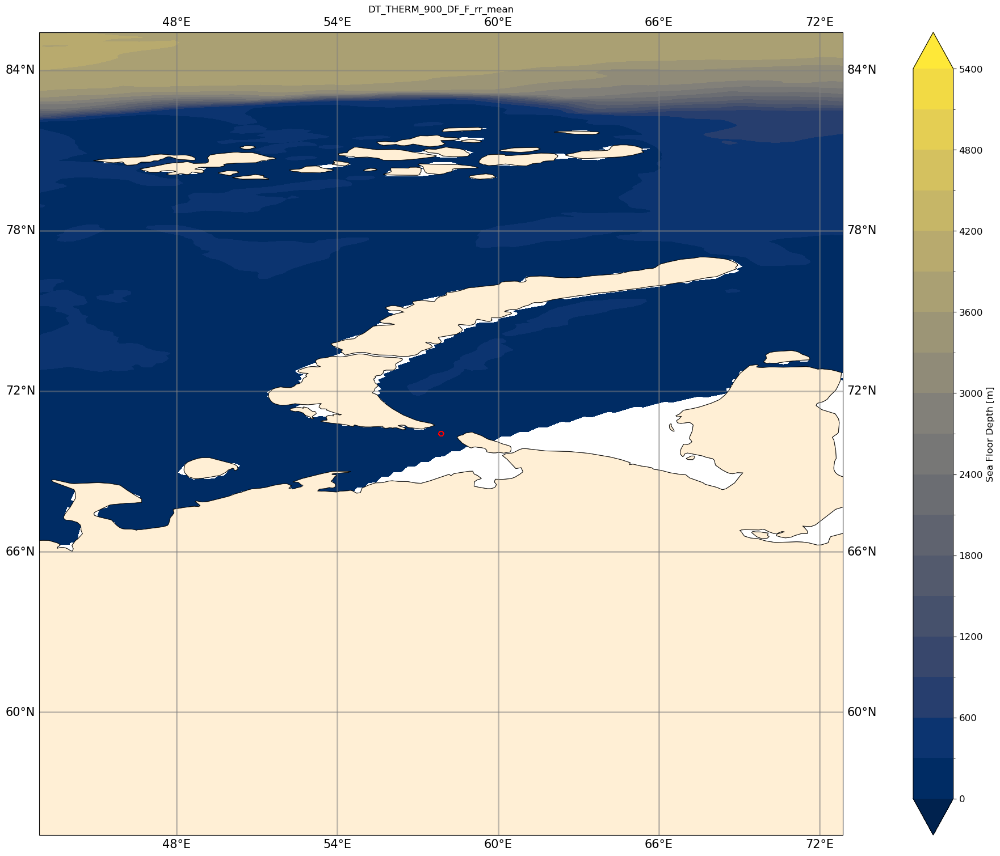

In [84]:
%%time
# truncation errors
zoom_in=15
plots_config = [
            {'var':'deptho',
             'indices': [-1],
             'base_index': None,
             'xlims': [57.875-zoom_in, 57.875+zoom_in],
             'ylims': [70.41154332-zoom_in, 70.41154332+zoom_in]
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
        frequency_fx='fx',
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                truncation_errors=True, trunc_variable='trunc_month', trunc_plot=None, MOM_dirs_path_tot = MOM_dirs_path_tot,
                project_ccrs=True, ccrs_circumpolar_plot=False,
                geo_plot=True,
                cmap='cividis',
                )
plt.tight_layout()

-4
-5
-6
-1
-2
-3
CPU times: user 8.25 s, sys: 896 ms, total: 9.15 s
Wall time: 8.39 s


<Figure size 640x480 with 0 Axes>

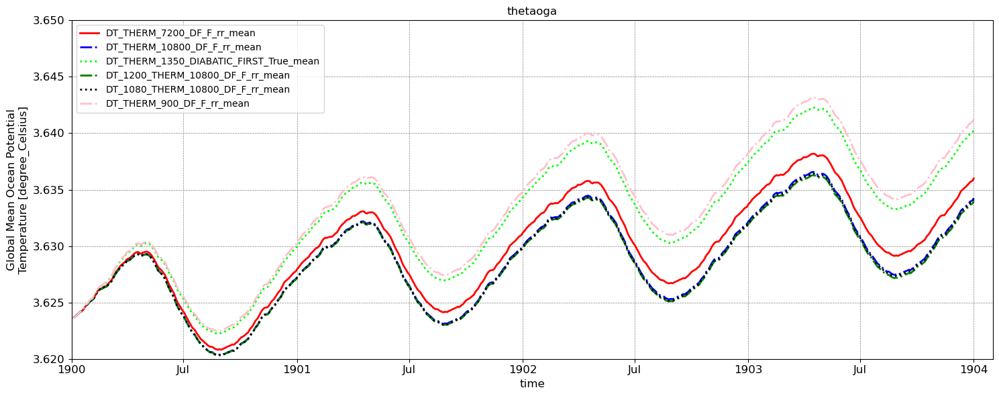

In [89]:
%%time
line_color = ['red','gold','pink','silver','pink','black','green','lime','blue','red']
line_color = ['red','gold','pink','silver','lime','blue','red','pink','black','green']
line_style = [':','-.','-','-.',':','-.']
#line_marker = ['o','s','v']
markersize = [5]
line_width = [2,2,2]
plots_config = [
            {'var':'thetaoga',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'thetaoga',
             'base_index': None,
             'ylims': [3.62, 3.65],
            },
            # {'var':'soga',
            #  'indices': [-4, -5, -6, -1, -2, -3],
            #  'title': 'soga',
            #  'base_index': None,
            #  #'ylims': [3.62, 3.65],
            # },
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,
                data_collect_method='scalar',
                line_style=line_style,
                line_color=line_color,
                #line_marker=line_marker,
                markersize=markersize,
                line_width=line_width,
                legend_loc = 'best',
                legend_fontsize = 10,
                plots_config=plots_config,
                figsize=(15,6),
                time_range = ['1900-01-01', '1904-02-01'],
                x_axis_time =True,
                xlims = ('1900-01-01', '1904-02-01'),
                )
plt.tight_layout()
# pic_name = "test_plot_timeseries"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=400)
# plt.show()

-4
-5
-6
-1
-2
-3
-4
-5
-6
-1
-2
-3


<Figure size 640x480 with 0 Axes>

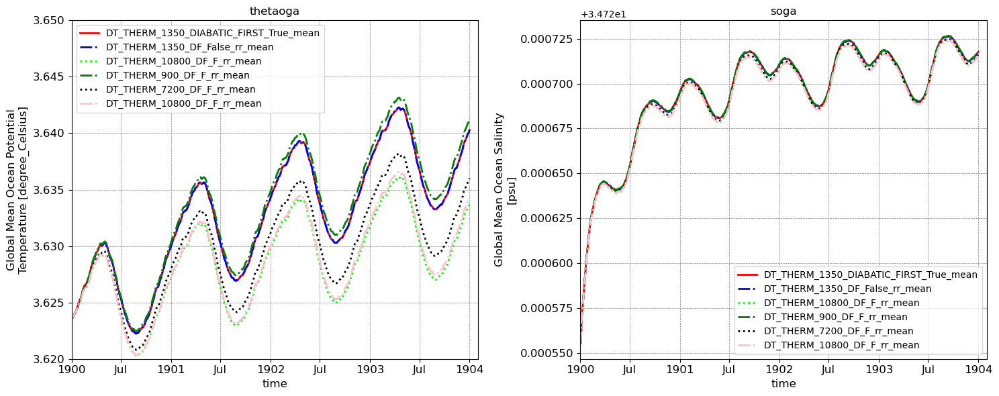

CPU times: user 17.8 s, sys: 1.36 s, total: 19.2 s
Wall time: 16.9 s


In [69]:
%%time
line_color = ['red','gold','pink','silver','pink','black','green','lime','blue','red']
line_color = ['red','gold','pink','silver','lime','blue','red','pink','black','green']
line_style = [':','-.','-','-.',':','-.']
#line_marker = ['o','s','v']
markersize = [5]
line_width = [2,2,2]
plots_config = [
            {'var':'thetaoga',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'thetaoga',
             'base_index': None,
             'ylims': [3.62, 3.65],
            },
            {'var':'soga',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'soga',
             'base_index': None,
             #'ylims': [3.62, 3.65],
            },
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,
                data_collect_method='scalar',
                line_style=line_style,
                line_color=line_color,
                #line_marker=line_marker,
                markersize=markersize,
                line_width=line_width,
                legend_loc = 'best',
                legend_fontsize = 10,
                plots_config=plots_config,
                figsize=(15,6),
                time_range = ['1900-01-01', '1904-02-01'],
                x_axis_time =True,
                xlims = ('1900-01-01', '1904-02-01'),
                )
plt.tight_layout()
pic_name = "global_temp_salinity"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

# Drake Passage Transport

In [ ]:
straits = {'Drake Passage': [ -69.9,  -69.9, -71.6, -51.0],
           'Lombok':        [-244.6, -243.9,  -8.6,  -8.6],
           'Ombai' :        [-235.0, -235.0,  -9.2,  -8.1],
           'Timor' :        [-235.9, -235.9, -11.9,  -9.9],
           'Denmark' :      [ -42.0,  -22.0,  65.8,  65.8],
           'Bering' :       [-172.0, -167.0,  65.8,  65.8],
           }

-4
Calculating Drake Passage
-5
Calculating Drake Passage
-6
Calculating Drake Passage
-1
Calculating Drake Passage
-2
Calculating Drake Passage
-3
Calculating Drake Passage
-4
Calculating Ombai
-5
Calculating Ombai
-6
Calculating Ombai
-1
Calculating Ombai
-2
Calculating Ombai
-3
Calculating Ombai
-4
Calculating Timor
-5
Calculating Timor
-6
Calculating Timor
-1
Calculating Timor
-2
Calculating Timor
-3
Calculating Timor
-4
Calculating Lombok
-5
Calculating Lombok
-6
Calculating Lombok
-1
Calculating Lombok
-2
Calculating Lombok
-3
Calculating Lombok
-4
North of 65N the tripolar grid geometry brings complications and .sum('longitude') is wrong!
Calculating Denmark
-5
North of 65N the tripolar grid geometry brings complications and .sum('longitude') is wrong!
Calculating Denmark
-6
North of 65N the tripolar grid geometry brings complications and .sum('longitude') is wrong!
Calculating Denmark
-1
North of 65N the tripolar grid geometry brings complications and .sum('longitude') is wrong

<Figure size 640x480 with 0 Axes>

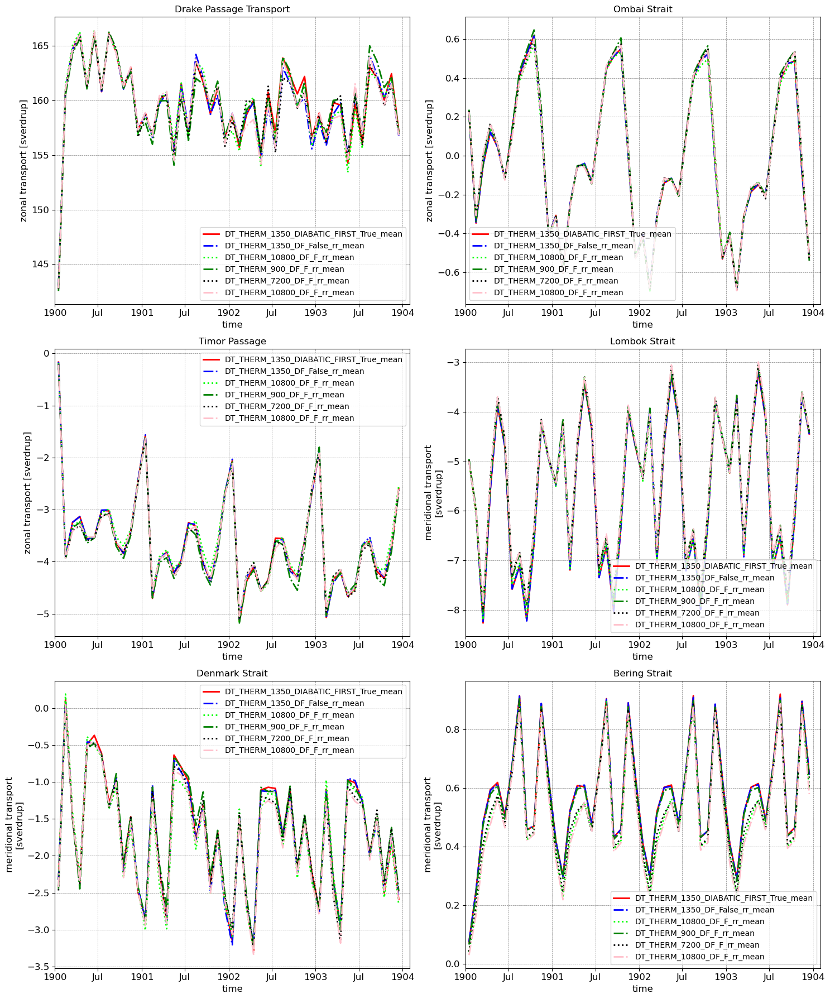

CPU times: user 8min 18s, sys: 1min 7s, total: 9min 26s
Wall time: 12min 17s


In [71]:
%%time
line_color = ['red','gold','pink','silver','lime','blue','red','pink','black','green']
line_style = [':','-.','-','-.',':','-.']
line_width = [2,2,2]
plots_config = [
            {'var':'umo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Drake Passage Transport',
             'base_index': None,
             'strait': 'Drake Passage',
             #'ylims': [3.62, 3.65],
            },
            {'var':'umo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Ombai Strait',
             'base_index': None,
             'strait': 'Ombai',
            },
            {'var':'umo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Timor Passage',
             'base_index': None,
             'strait': 'Timor',
            },
            {'var':'vmo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Lombok Strait',
             'base_index': None,
             'strait': 'Lombok',
            },
            {'var':'vmo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Denmark Strait',
             'base_index': None,
             'strait': 'Denmark',
            },
            {'var':'vmo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Bering Strait',
             'base_index': None,
             'strait': 'Bering',
            },
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                line_style=line_style,
                line_color=line_color,
                markersize=markersize,
                line_width=line_width,
                legend_loc = 'best',
                legend_fontsize = 10,
                plots_config=plots_config,
                figsize=(15,18),
                time_range = ['1900-01-01', '1904-02-01'],
                x_axis_time = True,
                xlims = ('1900-01-01', '1904-02-01'),
                )
plt.tight_layout()
pic_name = "Transports"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

-4
-5
-6
-1
-2
-3


<Figure size 640x480 with 0 Axes>

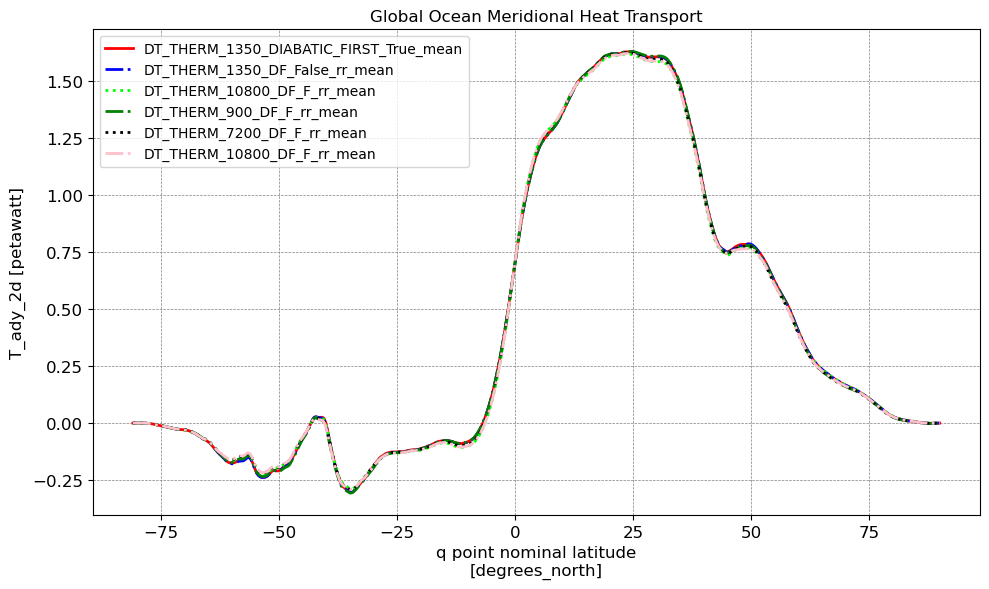

CPU times: user 20.1 s, sys: 956 ms, total: 21.1 s
Wall time: 17 s


In [74]:
%%time
line_color = ['red','gold','pink','silver','lime','blue','red','pink','black','green']
line_style = [':','-.','-','-.',':','-.']
line_width = [2,2,2]
plots_config = [
            {'var':'T_ady_2d',
             'indices': [-4, -5, -6, -1, -2, -3],
             'title': 'Global Ocean Meridional Heat Transport',
             'base_index': None,
             'MHT_1': True,
            },
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                line_style=line_style,
                line_color=line_color,
                markersize=markersize,
                line_width=line_width,
                legend_loc = 'best',
                legend_fontsize = 10,
                plots_config=plots_config,
                figsize=(10,6),
                time_range = ['1900-01-01', '1904-02-01'],
                x_axis_time = False,
                )
plt.tight_layout()
pic_name = "Global Ocean Meridional Heat Transport_method1"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

all indices: [[-4]]
total subplots: 1 for 2d plots
0 -4
start plotting...
contourf21
CPU times: user 11.5 s, sys: 169 ms, total: 11.7 s
Wall time: 10.7 s


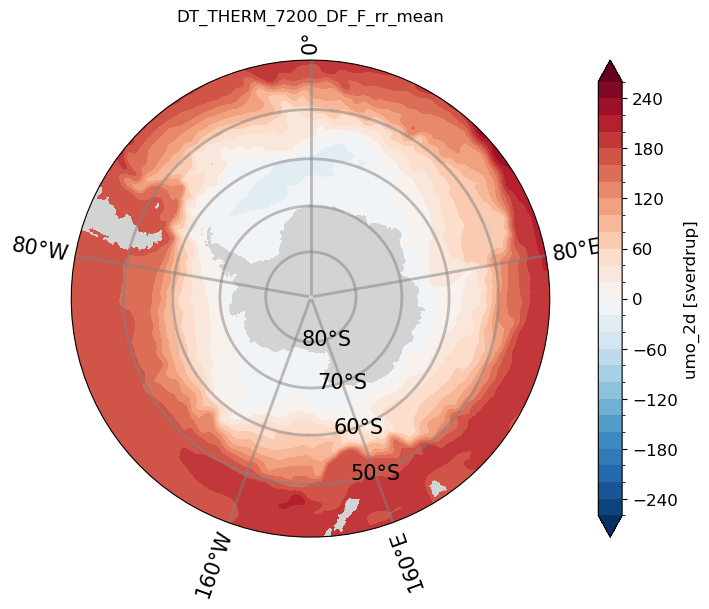

In [104]:
%%time
# test barotropic streamfunction
plots_config = [
            {'var':'umo_2d',
             'indices': [-4],
             'base_index': None,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(10,6),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                Barotropic_streamfunction=True, cf_mean_time=True, 
                project_ccrs=True, project_ccrs_method=ccrs.SouthPolarStereo(), ccrs_circumpolar_plot=True,land_mask_plot=True,
                geo_plot=True,
                levels=33,
                )
plt.tight_layout()

all indices: [[-4]]
total subplots: 1 for 2d plots
0 -4
start plotting...
pcolormesh2
CPU times: user 1min 41s, sys: 14.5 s, total: 1min 55s
Wall time: 1min 39s


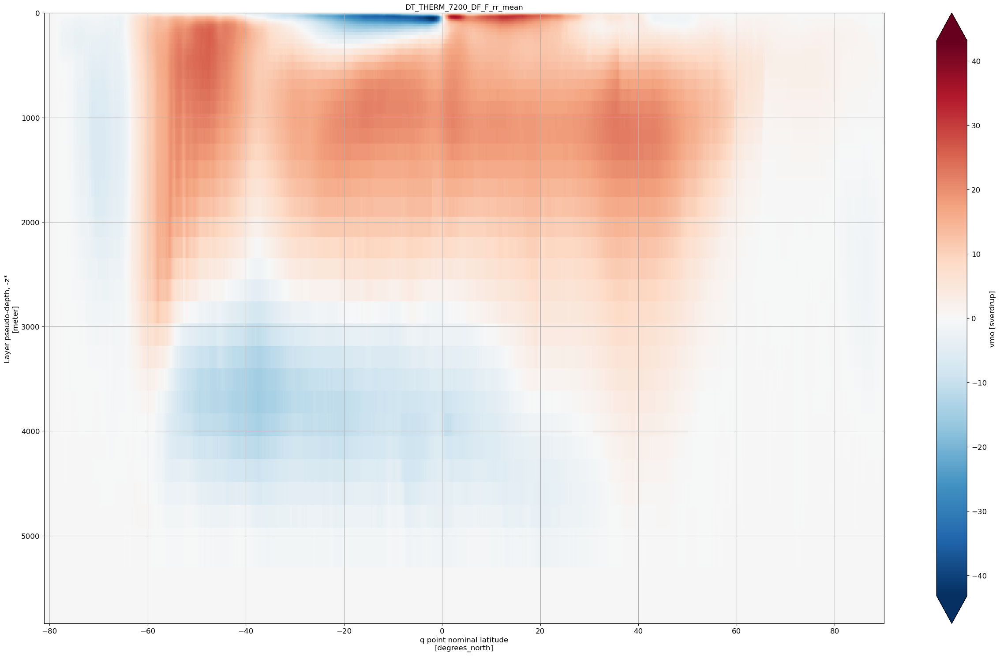

In [100]:
%%time
# test
plots_config = [
            {'var':'vmo',
             'indices': [-4],
             'base_index': None,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                MOC = True,
                cf_sum_lon=True, cf_cumsum_vertical=True, cf_mean_time=True, cf_mean_lon=False,
                plot_1d=False,
                yincrease = False,
                )
plt.tight_layout()


all indices: [[-4, -5, -6, -1, -2, -3]]
total subplots: 6 for 2d contourf plots
0 -4
1 -5
2 -6
3 -1
4 -2
5 -3


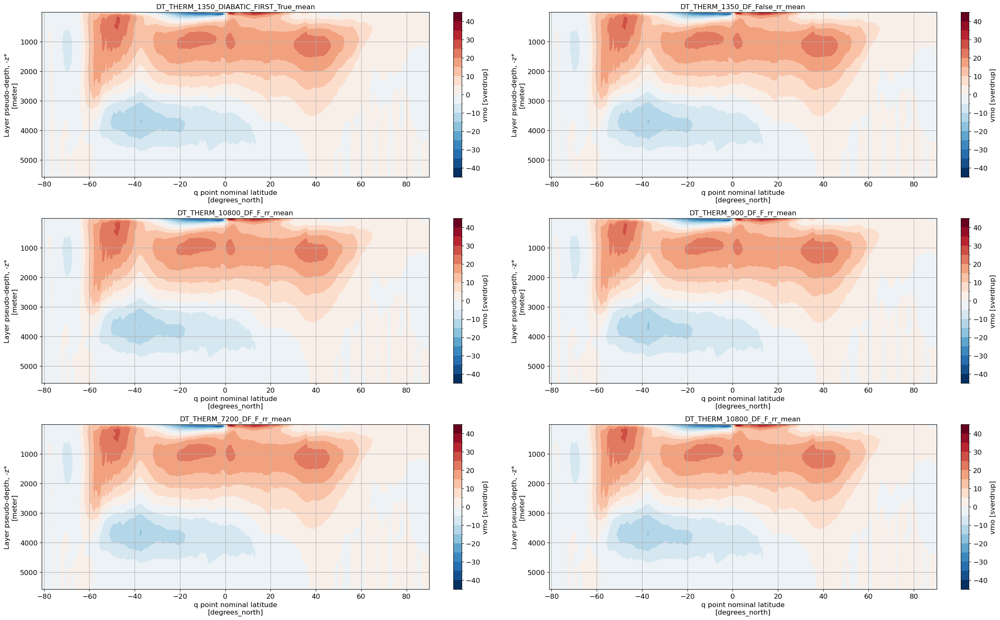

CPU times: user 14min 12s, sys: 1min 13s, total: 15min 25s
Wall time: 15min 46s


In [29]:
%%time
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
plots_config = [
            {'var':'vmo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': None,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                MOC = True,
                cf_sum_lon=True, cf_cumsum_vertical=True, cf_mean_time=True, cf_mean_lon=False,
                plot_1d=False,
                yincrease = False,
                )
plt.tight_layout()
pic_name = "MOC"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

all indices: [[-4, -5, -6, -1, -2, -3]]
total subplots: 6 for 2d contourf plots
process base_index: -4
finish processing base_index: -4
0 -4
1 -5
2 -6
3 -1
4 -2
5 -3


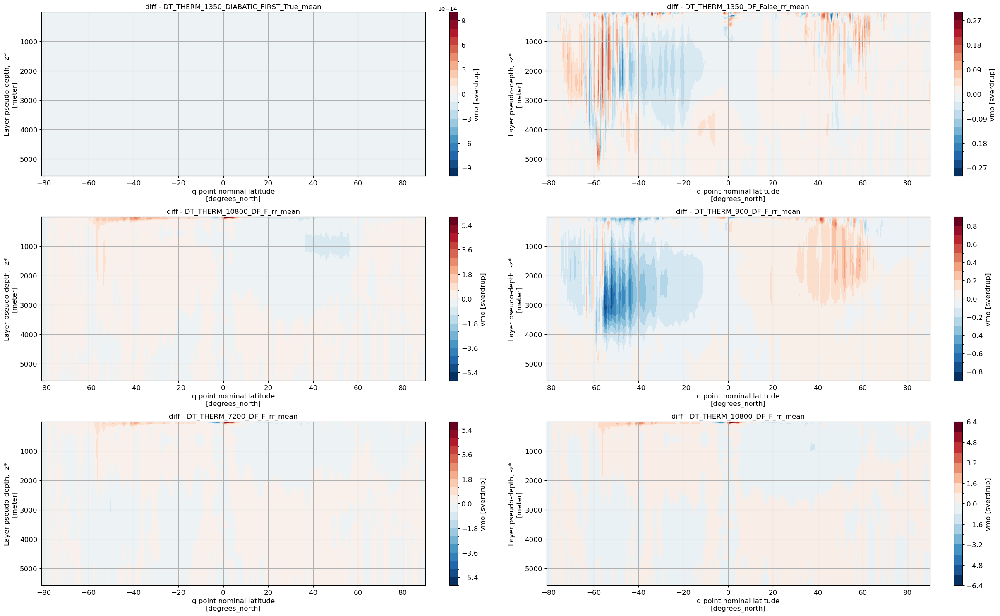

CPU times: user 27min 13s, sys: 1min 37s, total: 28min 50s
Wall time: 25min 22s


In [30]:
%%time
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
plots_config = [
            {'var':'vmo',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                MOC = True,
                cf_sum_lon=True, cf_cumsum_vertical=True, cf_mean_time=True, cf_mean_lon=False,
                plot_1d=False,
                yincrease = False,
                )
plt.tight_layout()
pic_name = "MOC_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

all indices: [[-4, -5, -6, -1, -2, -3]]
total subplots: 6 for 2d contourf plots
0 -4
1 -5
2 -6
3 -1
4 -2
5 -3


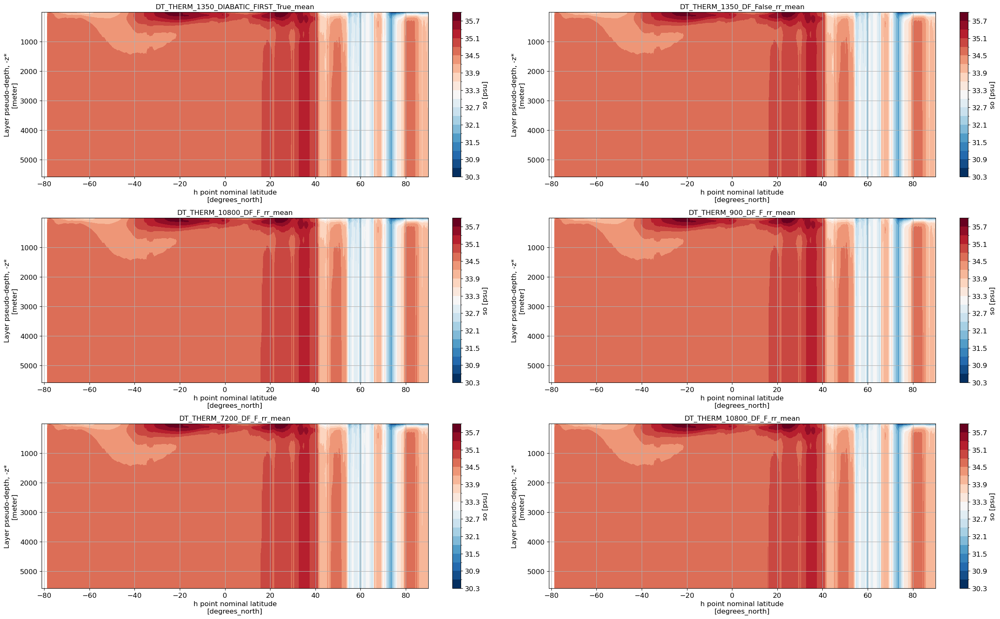

CPU times: user 13min 6s, sys: 54 s, total: 14min
Wall time: 15min 13s


In [15]:
%%time
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
plots_config = [
            {'var':'so',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': None,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
                plot_1d=False,
                yincrease = False,
                #cbar_range=[-28,28],
                )
plt.tight_layout()
pic_name = "so_depth_latitude"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

all indices: [[-4, -5, -6, -1, -2, -3]]
total subplots: 6 for 2d contourf plots
process base_index: -4
finish processing base_index: -4
0 -4
1 -5
2 -6
3 -1
4 -2
5 -3


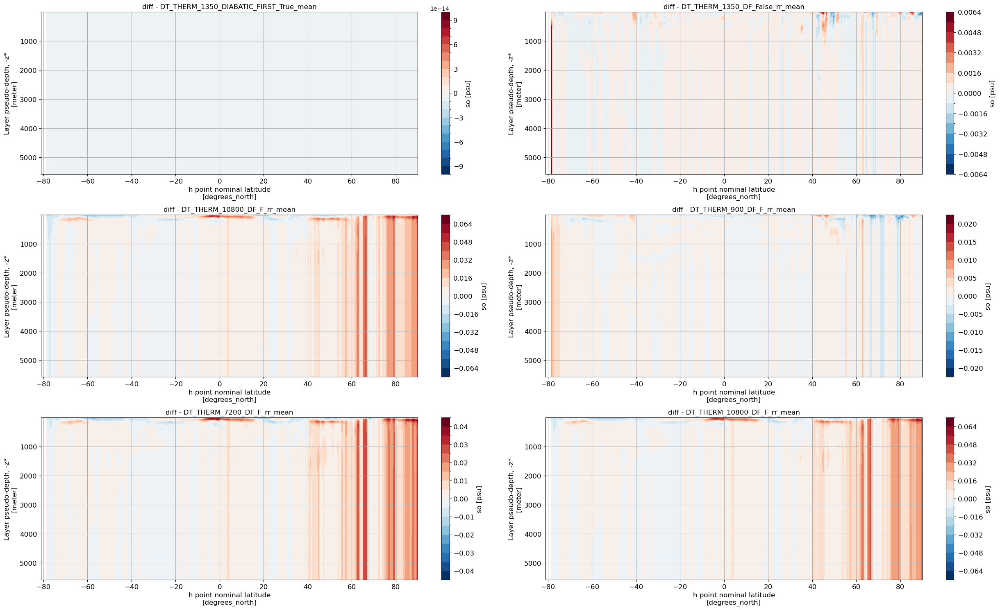

CPU times: user 23min 56s, sys: 1min 4s, total: 25min
Wall time: 22min 46s


In [31]:
%%time
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
plots_config = [
            {'var':'so',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
                plot_1d=False,
                yincrease = False,
                #cbar_range=[-28,28],
                )
plt.tight_layout()
pic_name = "so_depth_latitude_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

all indices: [[-4, -5, -6, -1, -2, -3]]
total subplots: 6 for 2d contourf plots
0 -4
1 -5
2 -6
3 -1
4 -2
5 -3


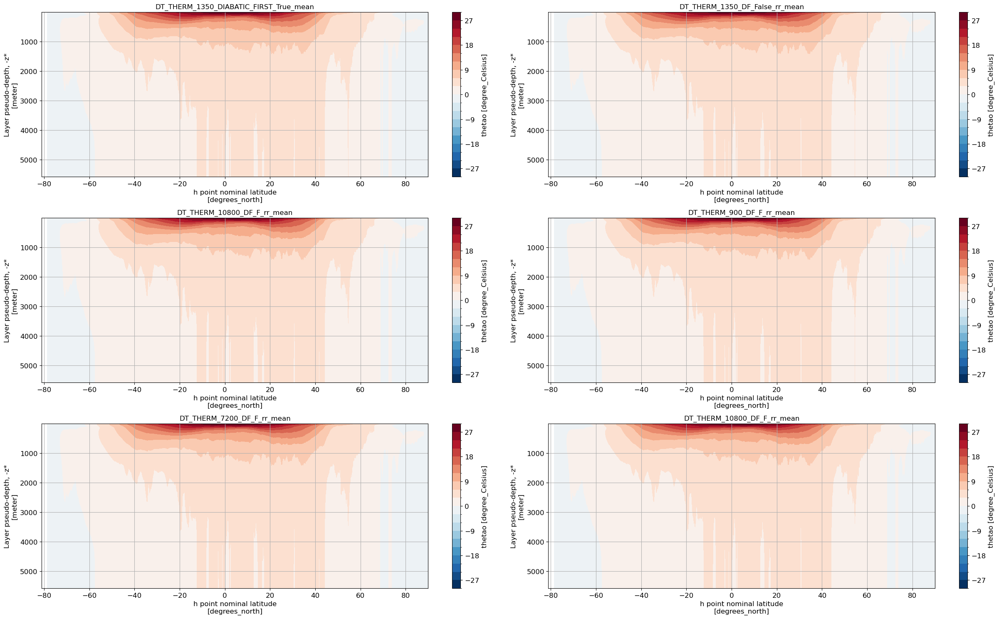

CPU times: user 13min 41s, sys: 45.8 s, total: 14min 27s
Wall time: 11min 57s


In [13]:
%%time
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
plots_config = [
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': None,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
                plot_1d=False,
                yincrease = False,
                #cbar_range=[-28,28],
                )
plt.tight_layout()
pic_name = "thetao_depth_latitude"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

all indices: [[-4, -5, -6, -1, -2, -3]]
total subplots: 6 for 2d contourf plots
process base_index: -4
finish processing base_index: -4
0 -4
1 -5
2 -6
3 -1
4 -2
5 -3


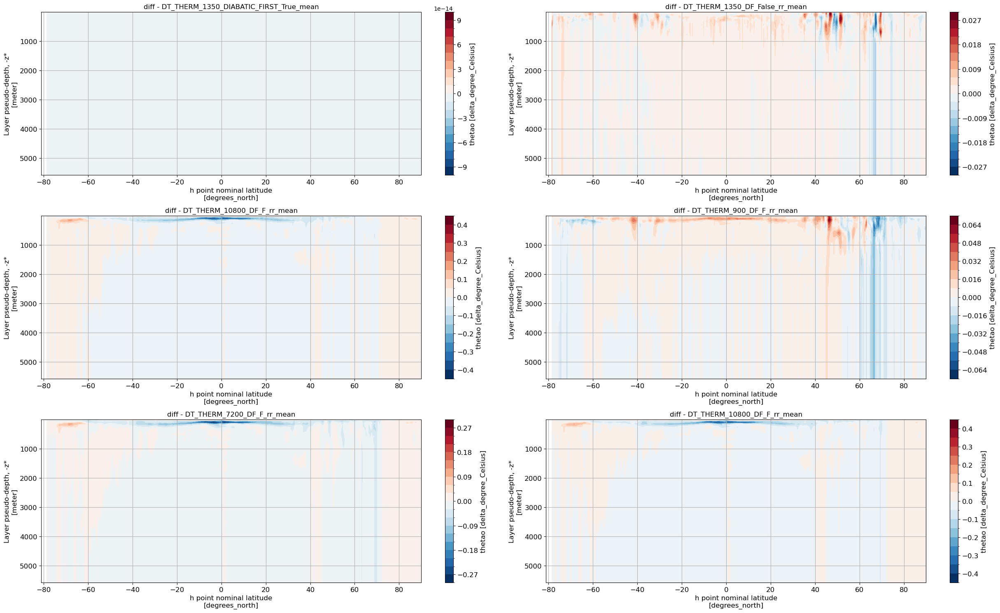

CPU times: user 26min 8s, sys: 1min 6s, total: 27min 14s
Wall time: 20min 57s


In [14]:
%%time
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
plots_config = [
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,15),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
                plot_1d=False,
                yincrease = False,
                #cbar_range=[-28,28],
                )
plt.tight_layout()
pic_name = "thetao_depth_latitude_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

In [1]:
%%time
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
plots_config = [
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':-60,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':-40,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':-20,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':0,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':20,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':40,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':60,
            },
            {'var':'thetao',
             'indices': [-4, -5, -6, -1, -2, -3],
             'base_index': -4,
             'select_yh': True,
             'yh_select':80,
            },
           ]
plot2d2(datastore_tot,MOM_names_tot,
                data_collect_method='mean',
                plots_config=plots_config,
                figsize=(25,20),
                time_selection = 'date_slice',
                time_range = ['1900-01-01', '1904-02-01'],
                cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
                plot_1d=True,
                line_style=line_style,
                line_color=line_color,
                line_width=line_width,
                )
plt.tight_layout()
pic_name = "thetao_depth_latitude_lines"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

NameError: name 'plot2d2' is not defined

0
1
2
3
4
5


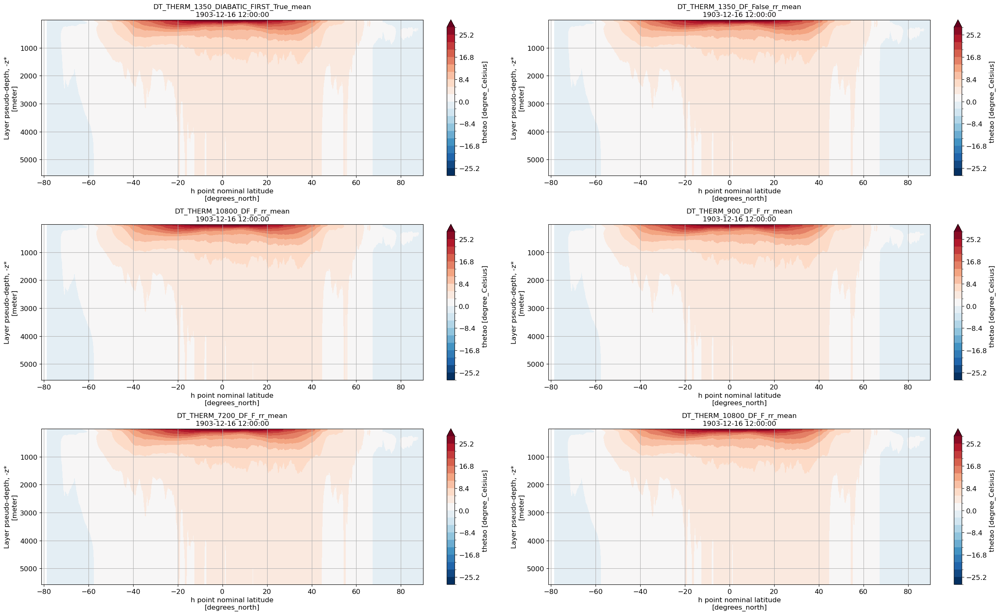

CPU times: user 23.9 s, sys: 4.07 s, total: 27.9 s
Wall time: 33.1 s


In [24]:
%%time
var = 'thetao'
common_time = pd.Timestamp('1904-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,MOM_names_expts,var,
       data_collect_method='mean',
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        yincrease = False,
        cbar_range=[-28,28],
       plot_1d=False,
      )
plt.tight_layout()
pic_name = "thetao_depth_latitude"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

0



KeyboardInterrupt



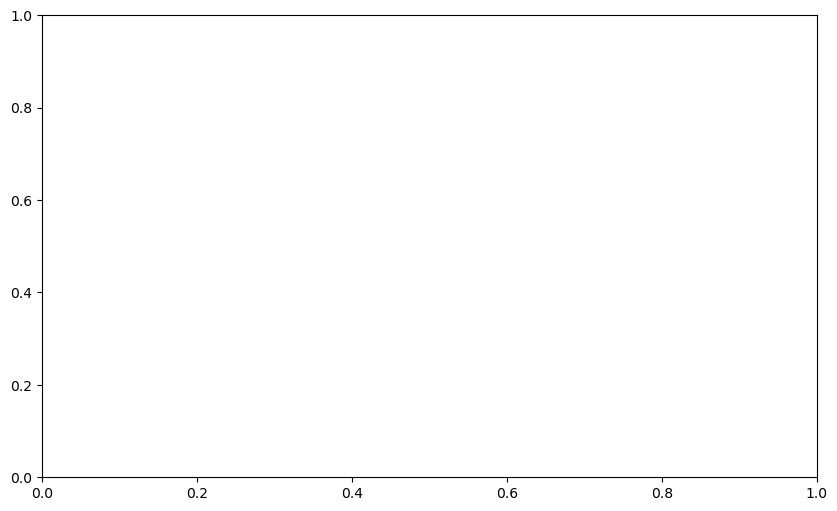

In [46]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = 0
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

0
1
2
3
4
5


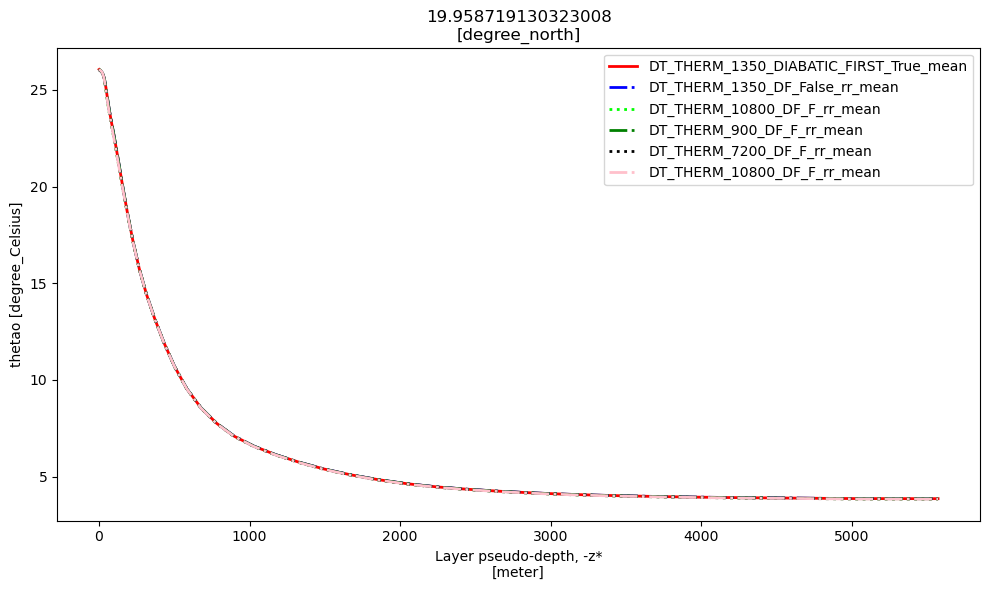

CPU times: user 3min 35s, sys: 21.2 s, total: 3min 57s
Wall time: 3min 20s


In [14]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = 20
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

0
1
2
3
4
5


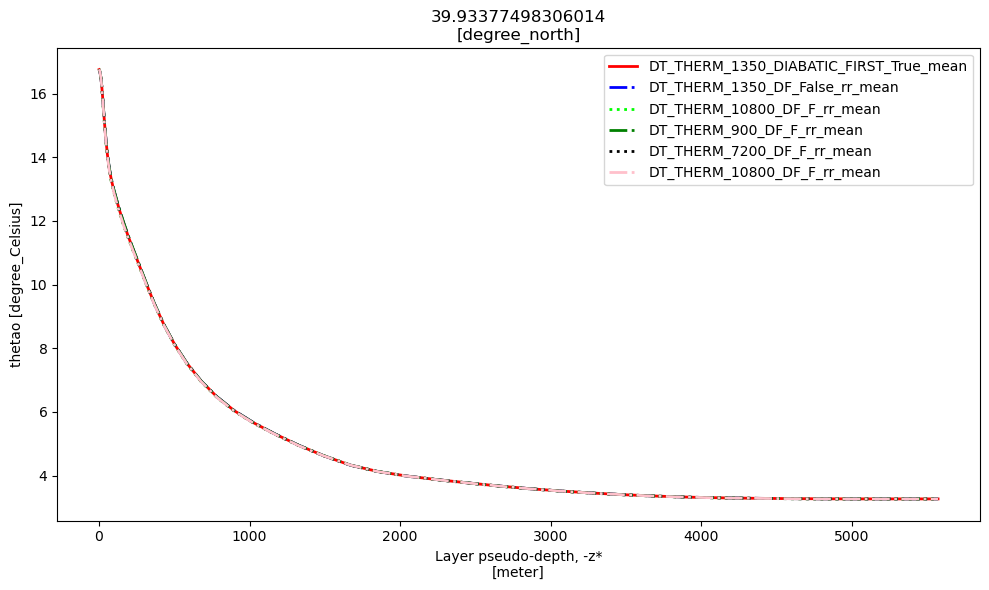

CPU times: user 3min 35s, sys: 19.7 s, total: 3min 55s
Wall time: 3min 17s


In [15]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = 40
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

0
1
2
3
4
5


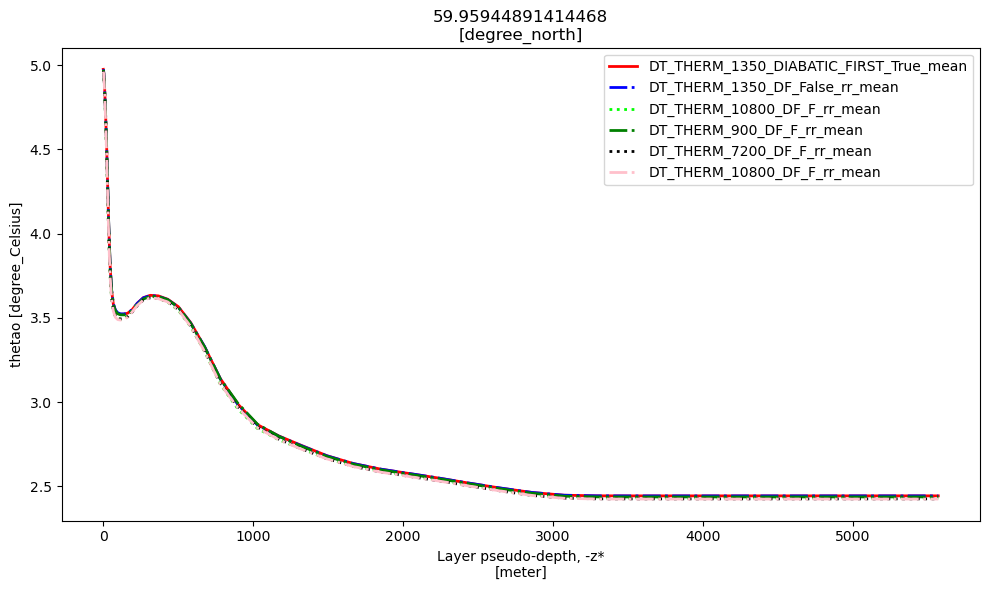

CPU times: user 3min 25s, sys: 16.4 s, total: 3min 41s
Wall time: 3min 3s


In [16]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = 60
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

0
1
2
3
4
5


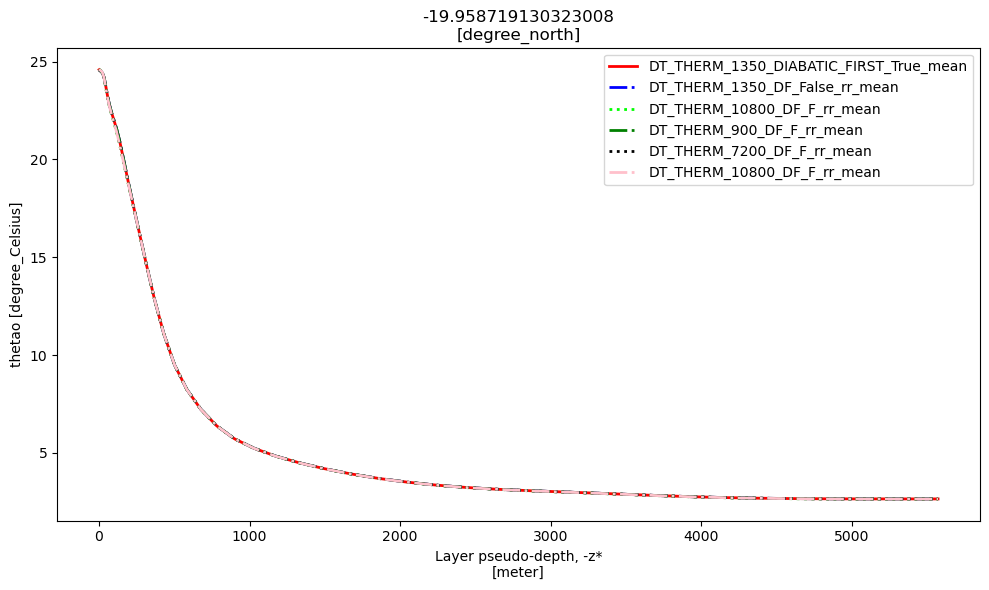

CPU times: user 3min 38s, sys: 23.1 s, total: 4min 1s
Wall time: 3min 26s


In [19]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = -20
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

[autoreload of plot_functions failed: Traceback (most recent call last):
  File "/g/data/hh5/public/apps/miniconda3/envs/analysis3-24.07/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/g/data/hh5/public/apps/miniconda3/envs/analysis3-24.07/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 475, in superreload
    module = reload(module)
  File "/g/data/hh5/public/apps/miniconda3/envs/analysis3-24.07/lib/python3.10/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 619, in _exec
  File "<frozen importlib._bootstrap_external>", line 879, in exec_module
  File "<frozen importlib._bootstrap_external>", line 1017, in get_code
  File "<frozen importlib._bootstrap_external>", line 947, in source_to_code
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/g/data/tm70/ml0072/COMMON/

0
1
2
3
4
5


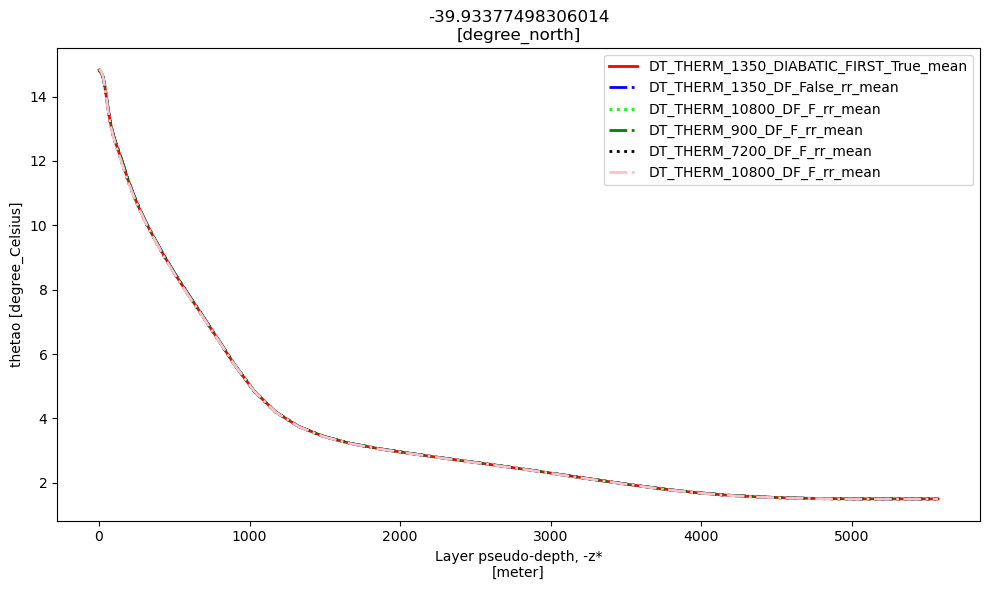

CPU times: user 3min 31s, sys: 25.8 s, total: 3min 57s
Wall time: 3min 36s


In [20]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = -40
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

0
1
2
3
4
5


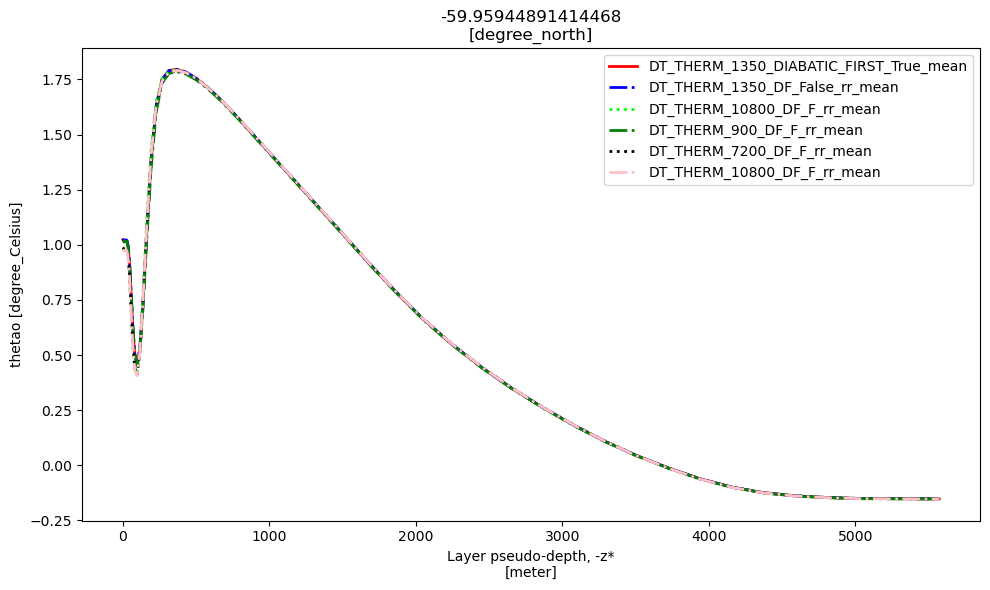

CPU times: user 3min 23s, sys: 26 s, total: 3min 49s
Wall time: 3min 15s


In [21]:
%%time
var = 'thetao'
# common_time = pd.Timestamp('1904-02-01 00:00:00')
# common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
#                                     common_time.hour, common_time.minute, common_time.second)
tmp_indx = [-4, -5, -6, -1, -2, -3]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
line_color = ['red','blue','lime','green','black','pink']
line_style = ['-','-.',':','-.',':','-.']
line_width = [2,2,2]
yh_select  = -60
plot2d(datastore_expts,MOM_names_expts,var,
        data_collect_method='mean',
        depth_level = None,
        time_selection = 'date_slice',
        start_time='1900-01-01',
        end_time='1904-02-01',
        ncols=2,figsize=(10,6),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=True, cf_mean_lon=True,
        plot_1d=True, yh_select=yh_select,
        line_style=line_style,
        line_color=line_color,
        line_width=line_width,
        # xlims=[0,1000], 
      )
plt.tight_layout()
pic_name = f"thetao_depth_latitude_line_yh_{yh_select}"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=400)
plt.show()

# Drake Passage Transport Difference

# Ombai Transport

# Ombai Transport difference

# Timor Transport

# Timor Transport difference

# Lombok Transport

# Lombok Transport difference

# Denmark Transport

# Denmark Transport difference

# Bering Transport

# Bering Transport difference

# Meridional Heat Transport

-1
-2
-3
-4


<Figure size 640x480 with 0 Axes>

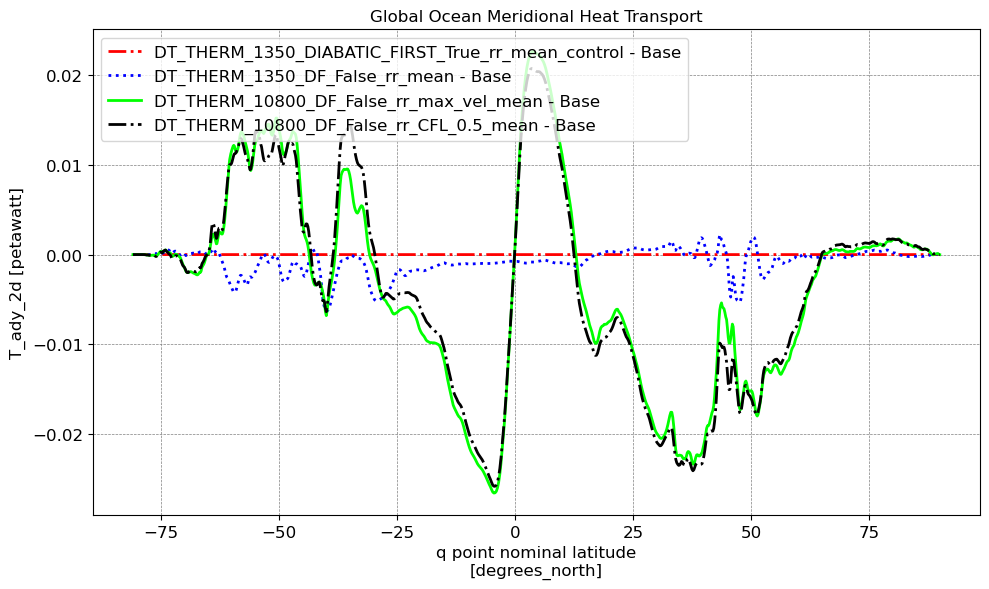

CPU times: user 22.1 s, sys: 836 ms, total: 22.9 s
Wall time: 17.2 s


In [23]:
%%time
var = 'T_ady_2d'
line_color = ['red','gold','pink','silver','cyan','black','lime','blue','red']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [-1, -2, -3, -4], 'title': 'Global Ocean Meridional Heat Transport', 'base_index': -1},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1904-02-01'],
                        use_subplots=False,
                        x_axis_time = False,
                        #xlims = (-15,15),
                        MHT_1=True,
                        #ylims = [3.62, 3.65],
                        )
plt.tight_layout()
pic_name = "Global Ocean Meridional Heat Transport_method1_diff_2"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

-1
-2
-3
-4
CPU times: user 11min 35s, sys: 1min 47s, total: 13min 23s
Wall time: 9min 9s


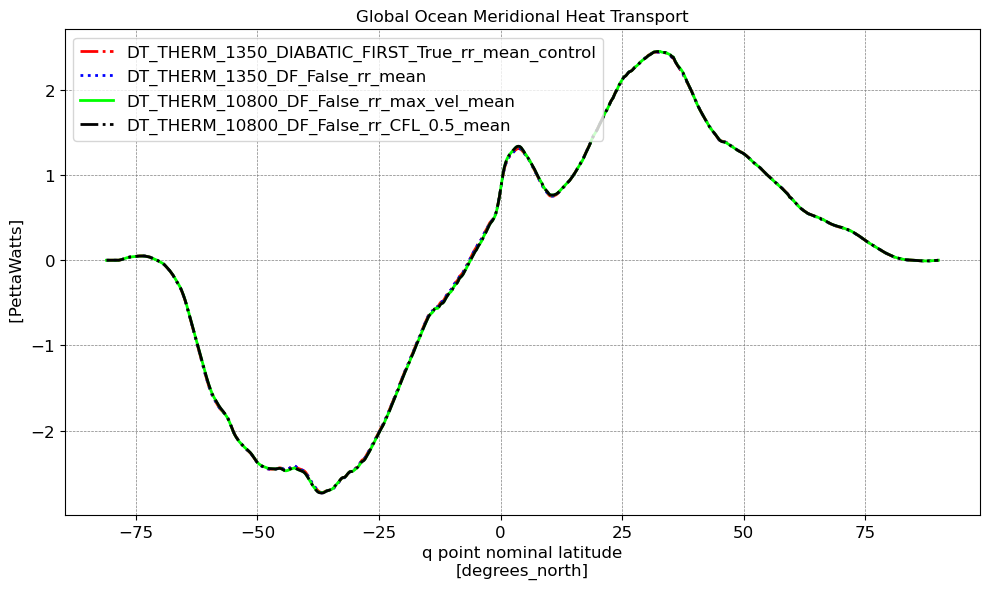

In [15]:
%%time
var = 'T_ady_2d'
line_color = ['red','gold','pink','silver','cyan','black','lime','blue','red']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [-1, -2, -3, -4], 'title': 'Global Ocean Meridional Heat Transport', 'base_index': None},
           ]
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1902-02-01'],
                        use_subplots=False,
                        x_axis_time = False,
                        #xlims = (-15,15),
                        MHT_3=True,
                        #ylims = [3.62, 3.65],
                        )
plt.tight_layout()

# Meridional Overturning Circulation (MOC)

0
1
2
3
CPU times: user 8min 28s, sys: 51.2 s, total: 9min 19s
Wall time: 14min 4s


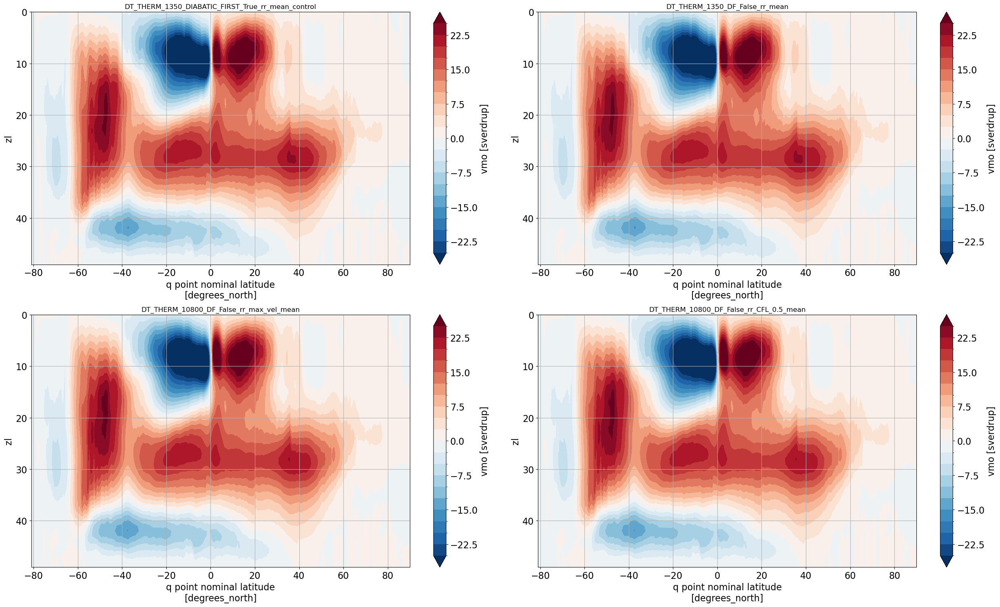

In [24]:
%%time
var = 'vmo'
tmp_indx = [-1, -2, -3, -4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        time_selection = 'date_slice',
        start_time = '1900-01-01',
        end_time = '1904-01-01',
        ncols=2,
        figsize=(25,15),
        MOC = True,
        cf_sum_lon = True,
        cf_cumsum_vertical = True,
        cf_mean_time = True,
        yincrease = False,
        remap_vertical_to_depth_coord = False,
        cbar_range=[-25,25],
      )
plt.tight_layout()
# pic_name = "MOC"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

# plot2d(datastore_expts,
#         MOM_names_expts,
#         var,
#         depth_level = None,
#         common_time = common_time,ncols=2,figsize=(25,15),
#         cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
#         yincrease = False,
#         #cbar_range=[-0.02, 0.02],
#       )


<xarray.Dataset> Size: 6MB
Dimensions:   (yh: 1080, xq: 1440)
Coordinates:
  * xq        (xq) float64 12kB -279.8 -279.5 -279.2 -279.0 ... 79.5 79.75 80.0
  * yh        (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
Data variables:
    T_adx_2d  (yh, xq) float32 6MB dask.array<chunksize=(1080, 1440), meta=np.ndarray>
0
1
2
3


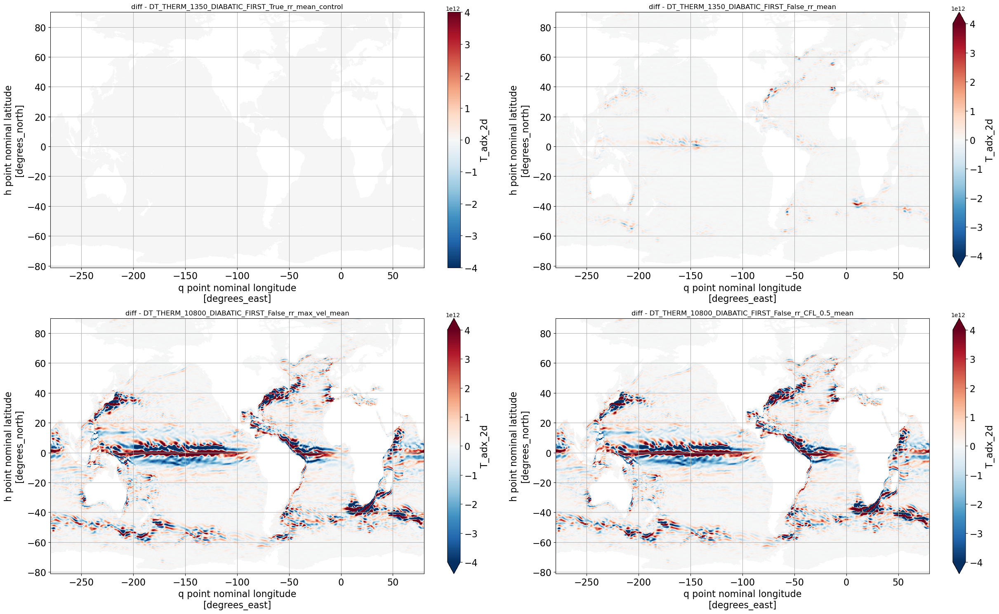

In [39]:
var = 'T_adx_2d'
tmp_indx = [-1, -2, -3, -4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        #common_time = common_time,
        time_selection = 'date_slice',
        start_time = '1900-01-01',
        end_time = '1901-01-01',
        ncols=2,
        figsize=(25,15),
        cbar_range=[-4e12,4e12]
      )
plt.tight_layout()
# pic_name = "T_adx_2d_diff"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

<xarray.Dataset> Size: 6MB
Dimensions:   (yh: 1080, xq: 1440)
Coordinates:
  * xq        (xq) float64 12kB -279.8 -279.5 -279.2 -279.0 ... 79.5 79.75 80.0
  * yh        (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
Data variables:
    T_adx_2d  (yh, xq) float32 6MB dask.array<chunksize=(1080, 1440), meta=np.ndarray>
0
1
2
3


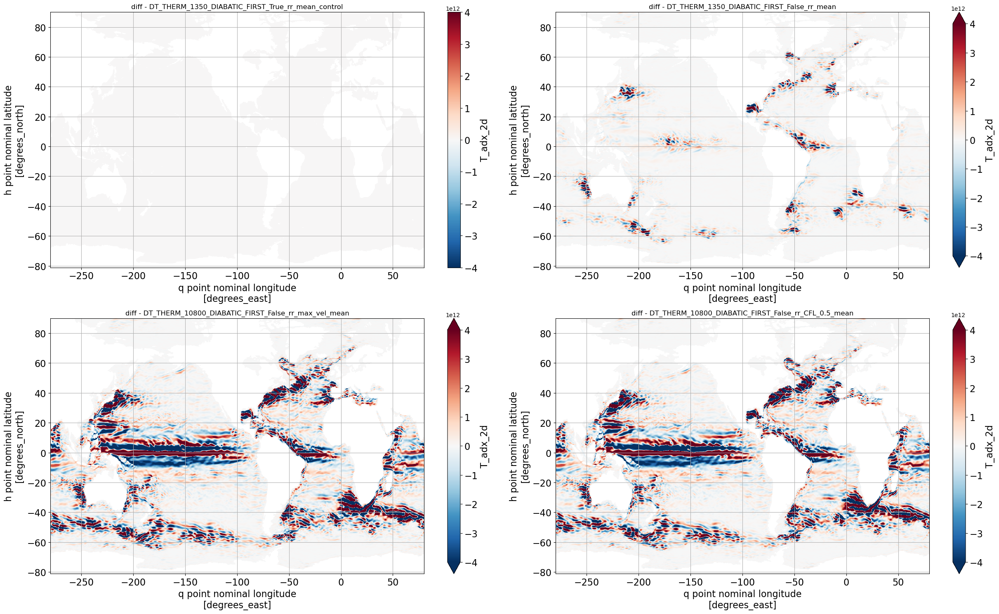

In [47]:
var = 'T_adx_2d'
tmp_indx = [-1, -2, -3, -4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        #common_time = common_time,
        time_selection = 'date_slice',
        start_time = '1901-01-01',
        end_time = '1902-01-01',
        ncols=2,
        figsize=(25,15),
        cbar_range=[-4e12,4e12]
      )
plt.tight_layout()
# pic_name = "T_adx_2d_diff"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

0
1
2
3


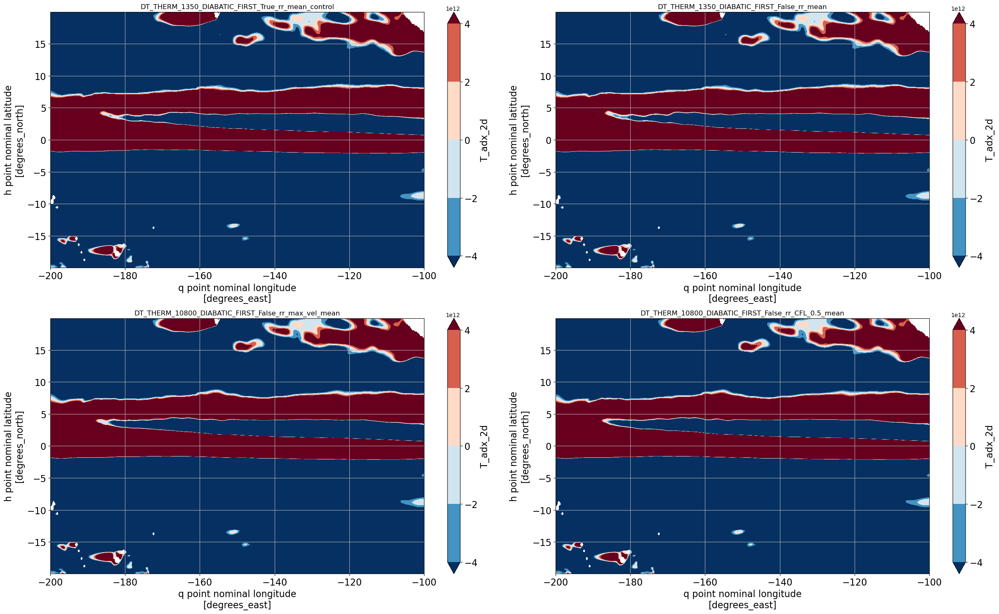

In [53]:
var = 'T_adx_2d'
tmp_indx = [-1, -2, -3, -4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        # datastore_ctrl = datastore_expts[2],
        depth_level = None,
        time_selection = 'date_slice',
        start_time = '1901-01-01',
        end_time = '1902-01-01',
        xq_subset=slice(-200,-100),
        yh_subset=slice(-20,20),
        ncols=2,
        figsize=(25,15),
        cbar_range=[-4e12,4e12],
        levels=5,
      )
plt.tight_layout()
# pic_name = "T_adx_2d_diff"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

<xarray.Dataset> Size: 6MB
Dimensions:   (yh: 1080, xq: 1440)
Coordinates:
  * xq        (xq) float64 12kB -279.8 -279.5 -279.2 -279.0 ... 79.5 79.75 80.0
  * yh        (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
Data variables:
    T_adx_2d  (yh, xq) float32 6MB dask.array<chunksize=(1080, 1440), meta=np.ndarray>
0
1
2
3


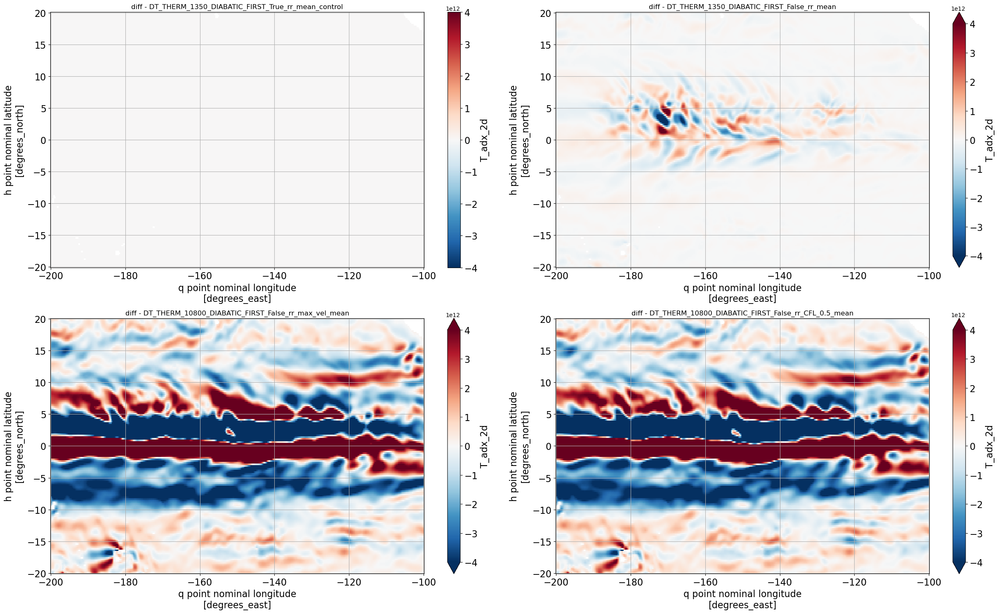

In [50]:
var = 'T_adx_2d'
tmp_indx = [-1, -2, -3, -4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        time_selection = 'date_slice',
        start_time = '1901-01-01',
        end_time = '1902-01-01',
        xq_subset=slice(-200,-100),
        yh_subset=slice(-20,20),
        ncols=2,
        figsize=(25,15),
        cbar_range=[-4e12,4e12]
      )
plt.tight_layout()
# pic_name = "T_adx_2d_diff"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

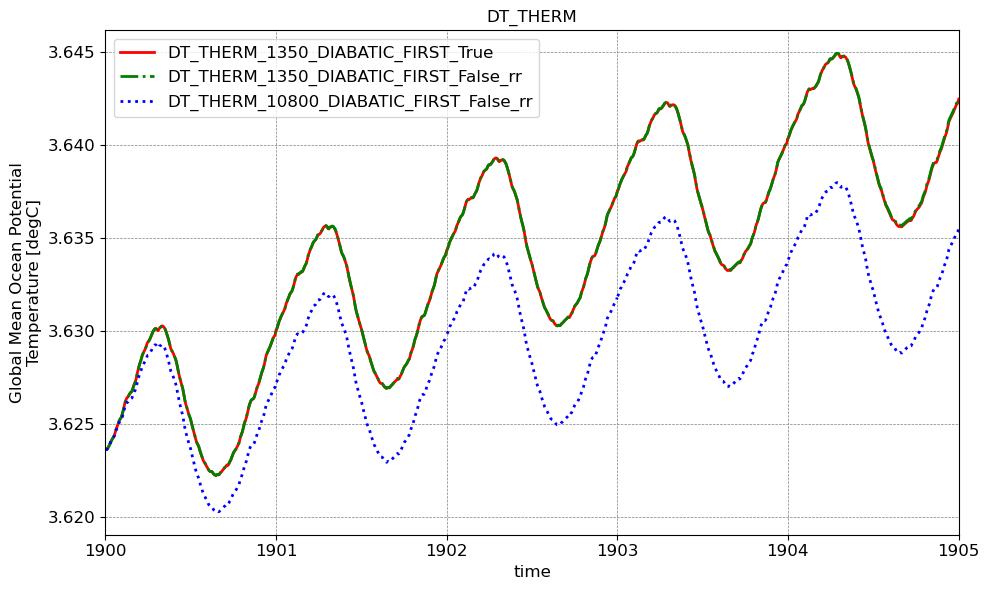

In [77]:
var = 'thetaoga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': None},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        #ylims = [3.62, 3.65],
                        )
plt.tight_layout()
pic_name = "thetaoga_compare"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

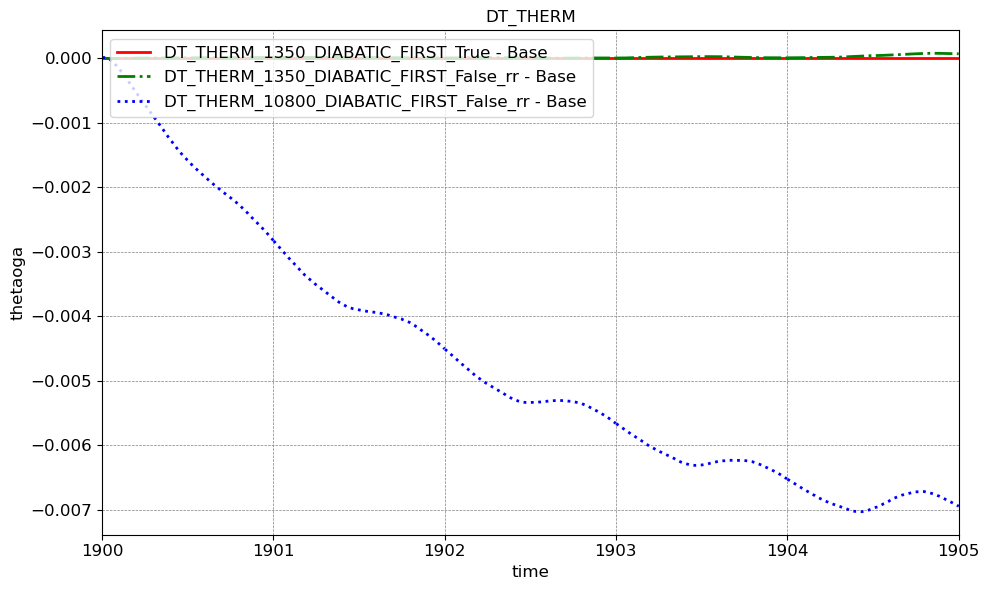

In [78]:
var = 'thetaoga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': 0},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        )
plt.tight_layout()
pic_name = "thetaoga_compare_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

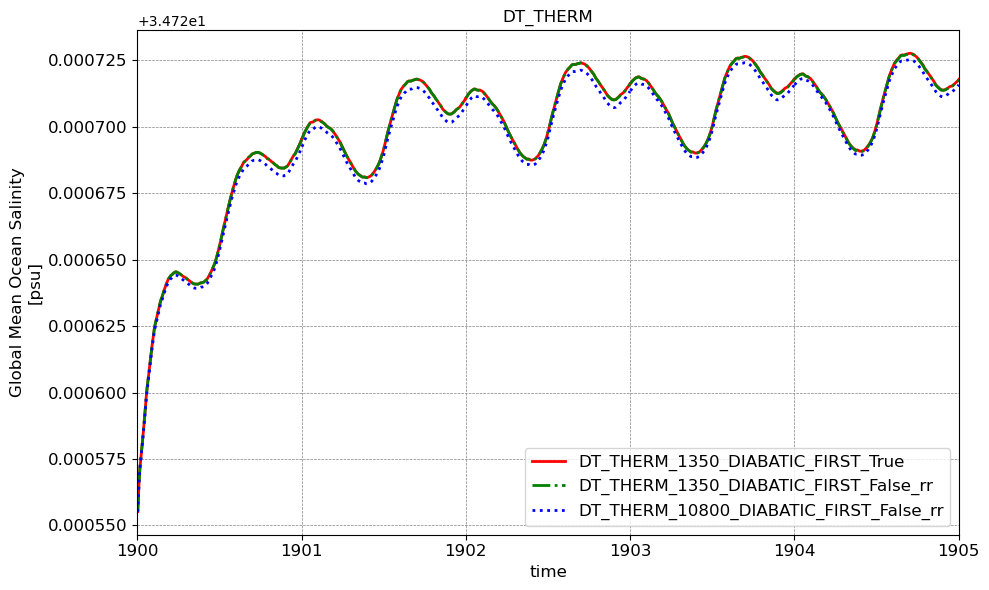

In [79]:
var = 'soga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': None},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'lower right',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        )
plt.tight_layout()
pic_name = "soga_compare"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

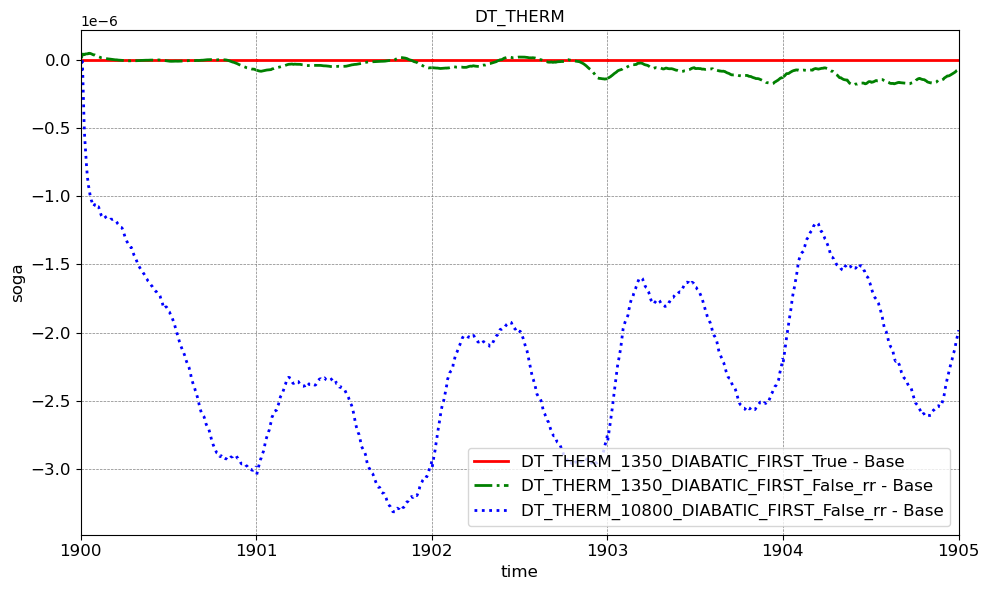

In [80]:
var = 'soga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': 0},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'best',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        )
plt.tight_layout()
pic_name = "soga_compare_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


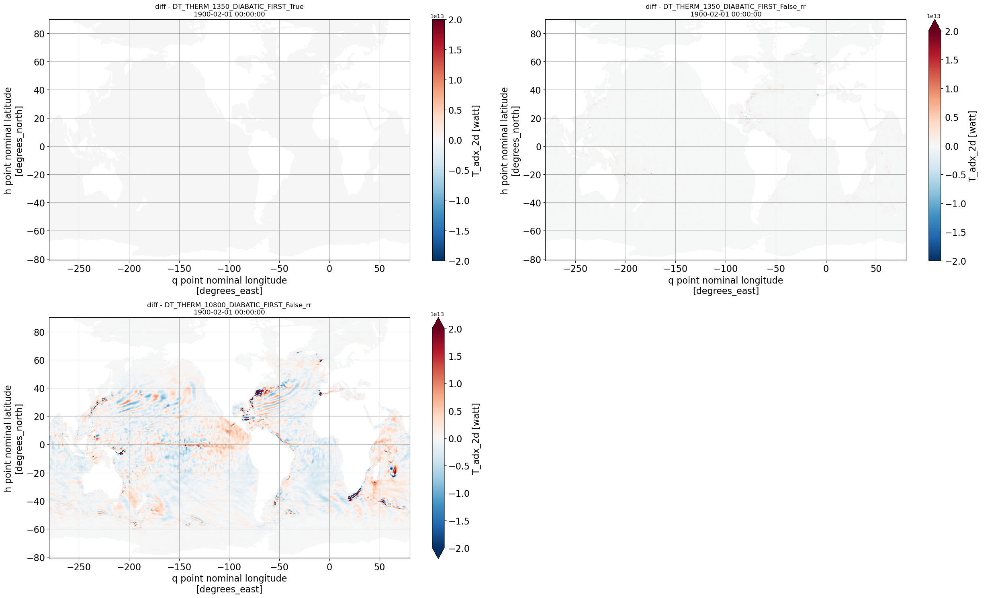

In [91]:
var = 'T_adx_2d'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-2e13,2e13]
      )
plt.tight_layout()
pic_name = "T_adx_2d_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

[<intake_esm_ds catalog with 1984 dataset(s) from 2665 asset(s)>, <intake_esm_ds catalog with 454 dataset(s) from 602 asset(s)>, <intake_esm_ds catalog with 454 dataset(s) from 602 asset(s)>]
['DT_THERM_1350_DIABATIC_FIRST_True', 'DT_THERM_1350_DIABATIC_FIRST_False_rr', 'DT_THERM_10800_DIABATIC_FIRST_False_rr']
0
1
2


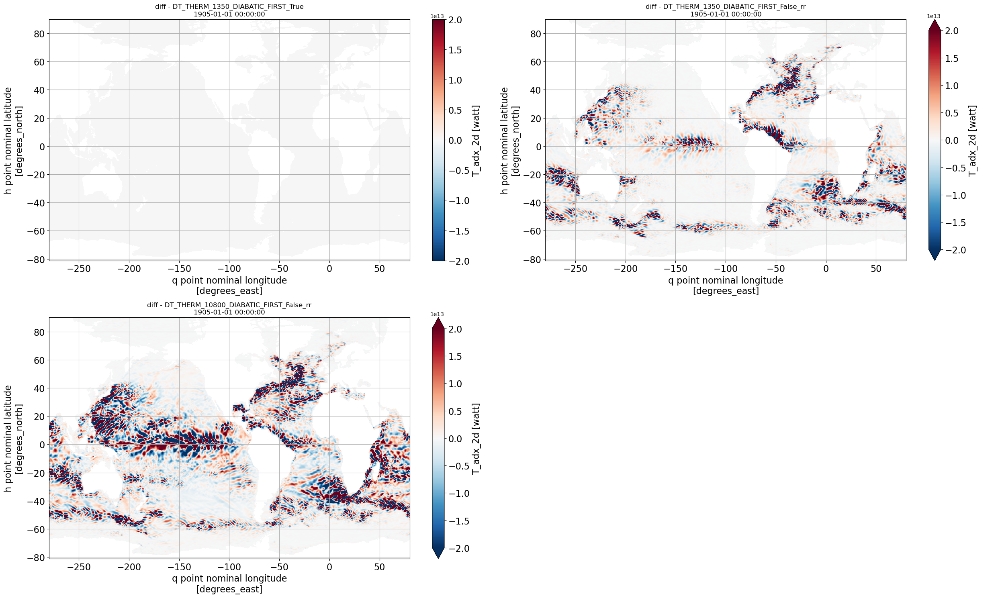

In [92]:
var = 'T_adx_2d'
common_time = pd.Timestamp('1905-01-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0, -1, -2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
print(datastore_expts)
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
print(MOM_names_expts)
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-2e13,2e13]
      )
plt.tight_layout()
pic_name = "T_adx_2d_diff_2"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


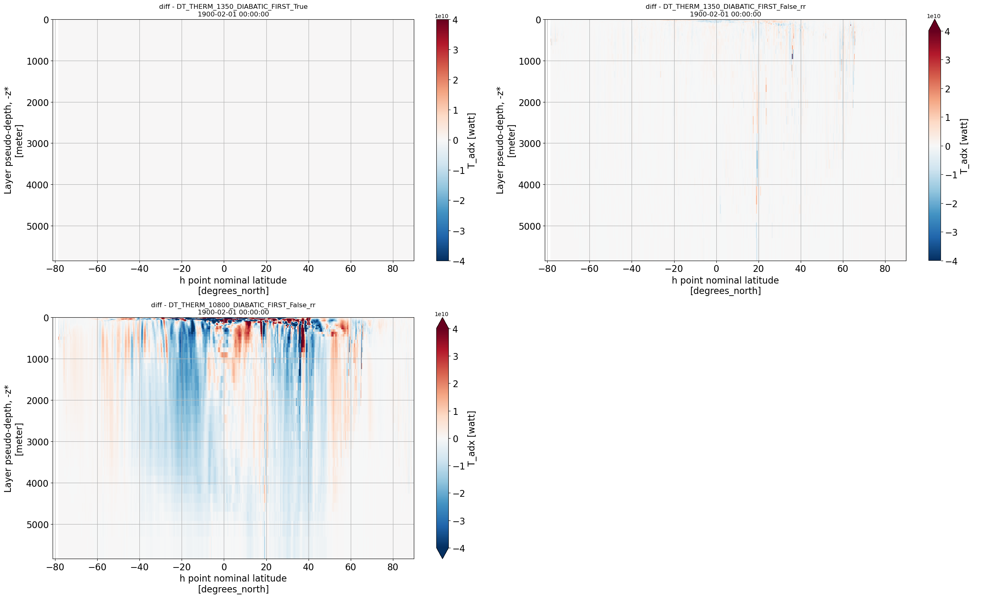

In [93]:
var = 'T_adx'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        cbar_range=[-4e10, 4e10],
        yincrease = False,
      )
plt.tight_layout()
pic_name = "T_adx_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


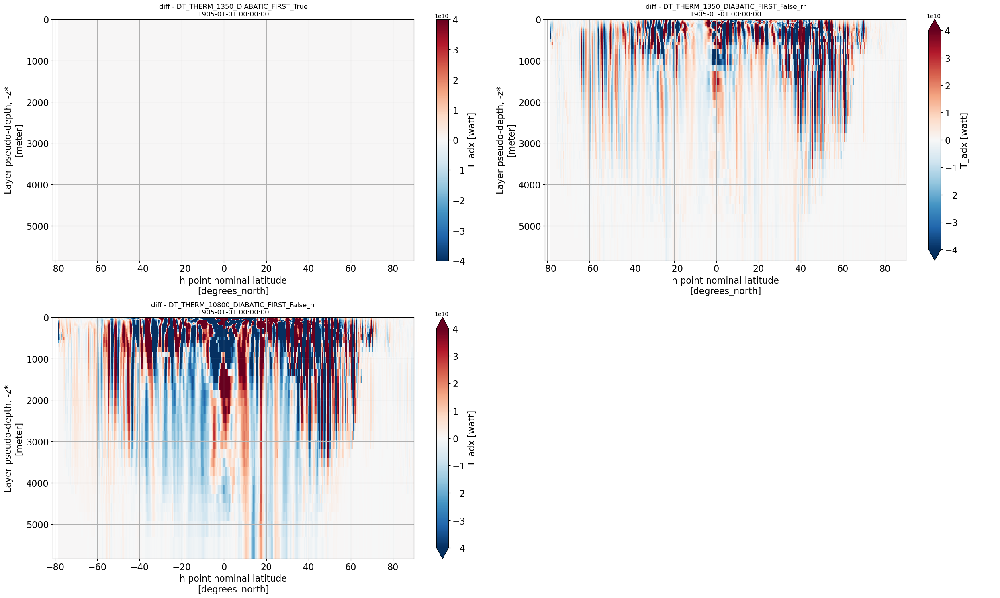

In [94]:
var = 'T_adx'
common_time = pd.Timestamp('1905-01-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        cbar_range=[-4e10, 4e10],
        yincrease = False,
      )
plt.tight_layout()
pic_name = "T_adx_diff_2"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
{'NumFilesInSet': 1, 'title': 'ACCESS-OM3', 'associated_files': 'areacello: access-om3.mom6.static.nc', 'grid_type': 'regular', 'grid_tile': 'N/A', 'intake_esm_vars': ['thetao'], 'intake_esm_attrs:path': '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/Ctrl-025deg_jra55do_ryf/archive/output017/access-om3.mom6.3d.thetao.1mon.snap.1917.nc', 'intake_esm_attrs:realm': 'ocean', 'intake_esm_attrs:variable': 'thetao', 'intake_esm_attrs:frequency': '1mon', 'intake_esm_attrs:start_date': '1917-02-01, 00:00:00', 'intake_esm_attrs:end_date': '1918-02-01, 00:00:00', 'intake_esm_attrs:variable_long_name': "['Sea Water Potential Temperature']", 'intake_esm_attrs:variable_standard_name': "['sea_water_potential_temperature']", 'intake_esm_attrs:variable_cell_methods': "['area:mean zl:mean yh:mean xh:mean time: point']", 'intake_esm_attrs:variable_units': "['degC']", 'intake_esm_attrs:filename': 'access-om3.mom6.3d.thetao.1mon.snap.1917.nc', 'intake_esm_attrs:fi

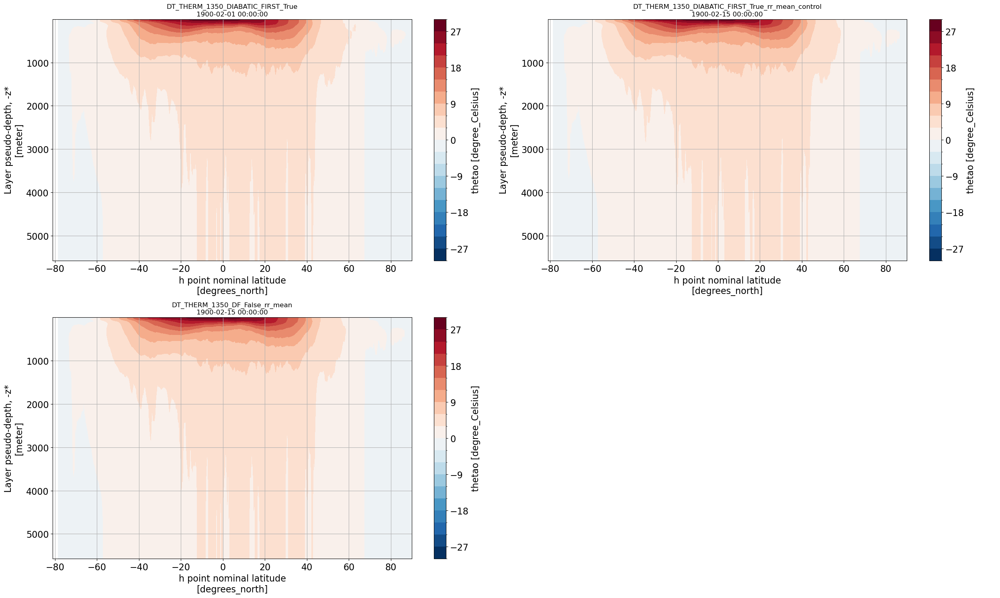

In [34]:
var = 'thetao'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        yincrease = False,
        #cbar_range=[-0.02, 0.02],
      )
plt.tight_layout()
# pic_name = "thetao"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

0
{'NumFilesInSet': 1, 'title': 'ACCESS-OM3', 'associated_files': 'areacello: access-om3.mom6.static.nc', 'grid_type': 'regular', 'grid_tile': 'N/A', 'intake_esm_vars': ['thetao'], 'intake_esm_attrs:path': '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/Ctrl-025deg_jra55do_ryf/archive/output008/access-om3.mom6.3d.thetao.1mon.snap.1908.nc', 'intake_esm_attrs:realm': 'ocean', 'intake_esm_attrs:variable': 'thetao', 'intake_esm_attrs:frequency': '1mon', 'intake_esm_attrs:start_date': '1908-02-01, 00:00:00', 'intake_esm_attrs:end_date': '1909-02-01, 00:00:00', 'intake_esm_attrs:variable_long_name': "['Sea Water Potential Temperature']", 'intake_esm_attrs:variable_standard_name': "['sea_water_potential_temperature']", 'intake_esm_attrs:variable_cell_methods': "['area:mean zl:mean yh:mean xh:mean time: point']", 'intake_esm_attrs:variable_units': "['degC']", 'intake_esm_attrs:filename': 'access-om3.mom6.3d.thetao.1mon.snap.1908.nc', 'intake_esm_attrs:fi

ValueError: ('date is not consistent for the two datasets ', '1900-02-15 00:00:00 and 1900-02-01 00:00:00')

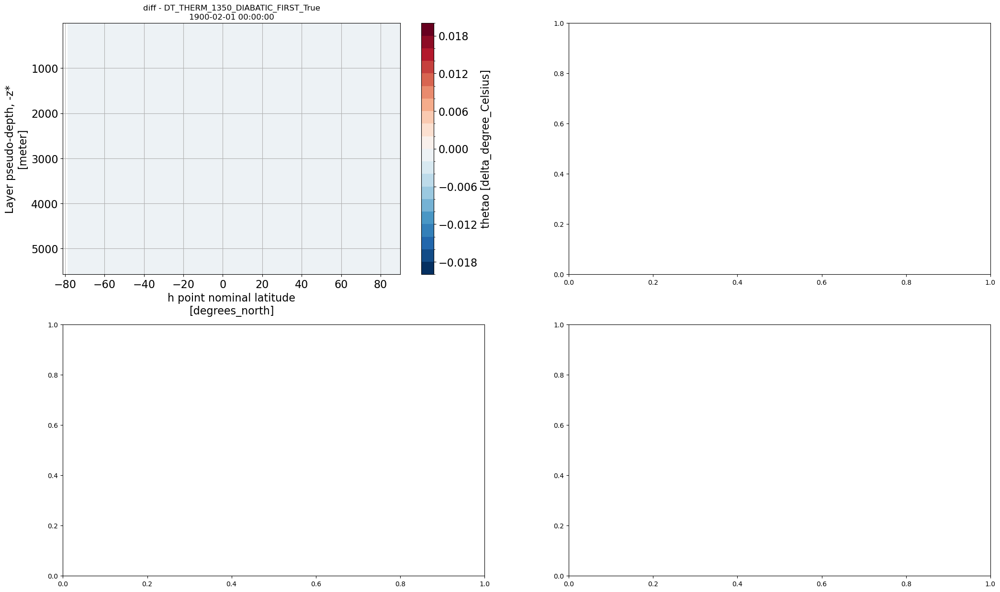

In [33]:
var = 'thetao'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        yincrease = False,
        cbar_range=[-0.02, 0.02],
      )
plt.tight_layout()
# pic_name = "thetao_diff"
# file_path = os.path.join(pics_folder, pic_name+ ".png")
# plt.savefig(file_path,dpi=300)
# plt.show()

0
1
2


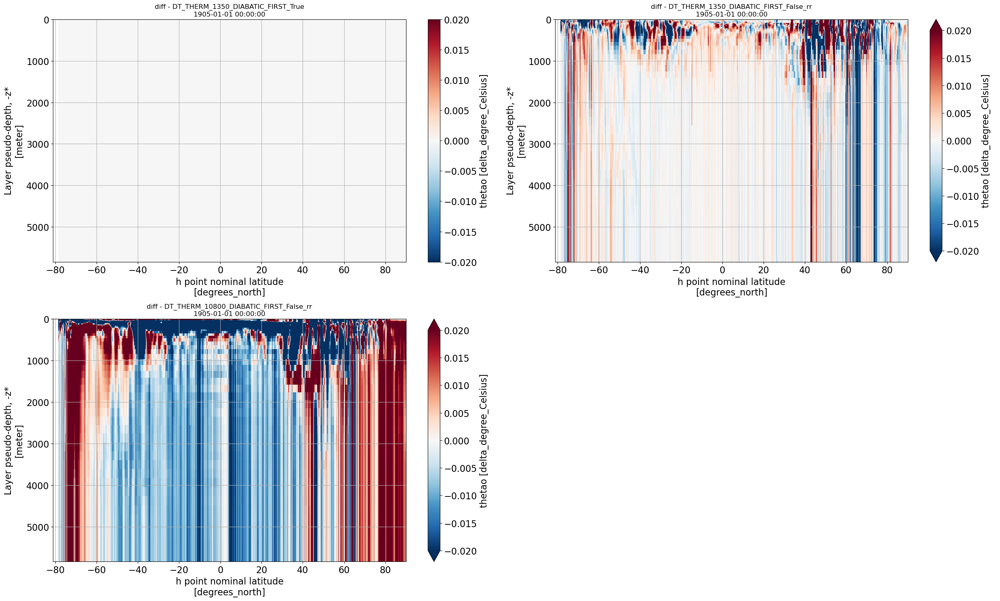

In [108]:
var = 'thetao'
common_time = pd.Timestamp('1905-01-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_cumsum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        yincrease = False,
        cbar_range=[-0.02, 0.02],
      )
plt.tight_layout()
pic_name = "thetao_diff_2"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


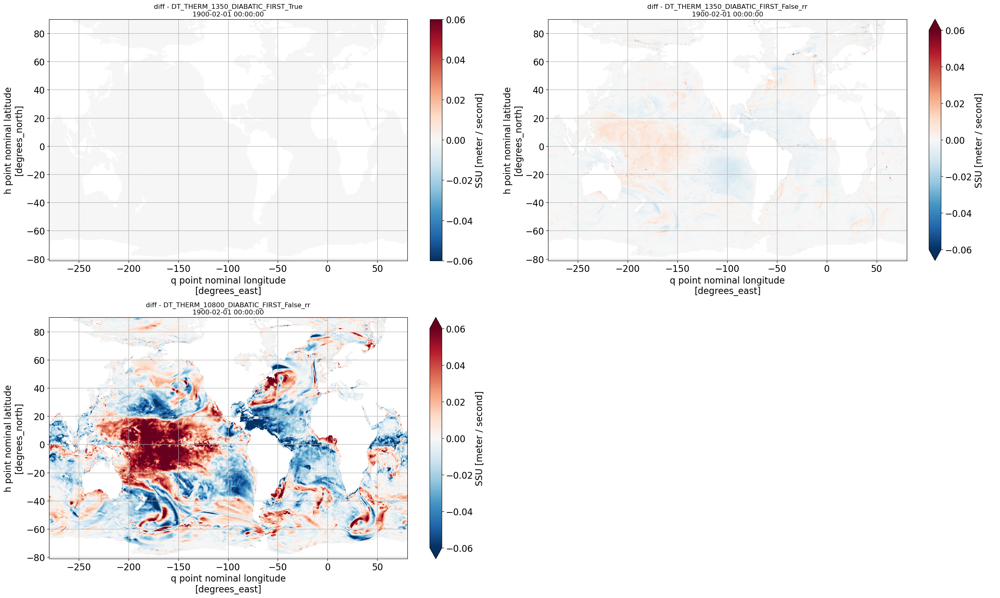

In [97]:
var = 'SSU'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        # xq_subset=slice(50,80),
        # yh_subset=slice(-40,-10),
        cbar_range=[-0.06, 0.06],
        )
plt.tight_layout()
pic_name = "SSU_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


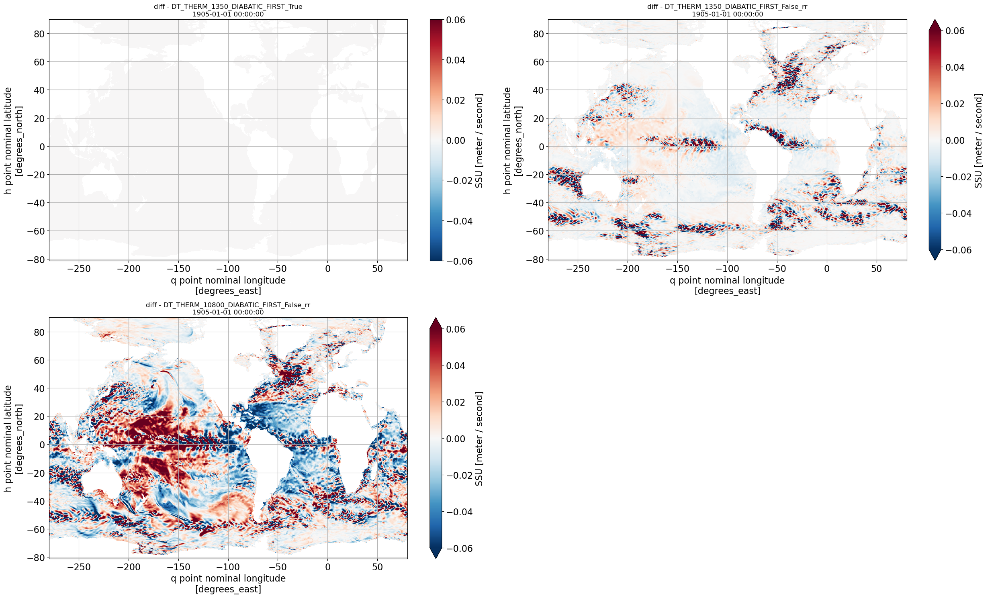

In [98]:
var = 'SSU'
common_time = pd.Timestamp('1905-01-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        # xq_subset=slice(50,80),
        # yh_subset=slice(-40,-10),
        cbar_range=[-0.06, 0.06],
        )
plt.tight_layout()
pic_name = "SSU_diff_2"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


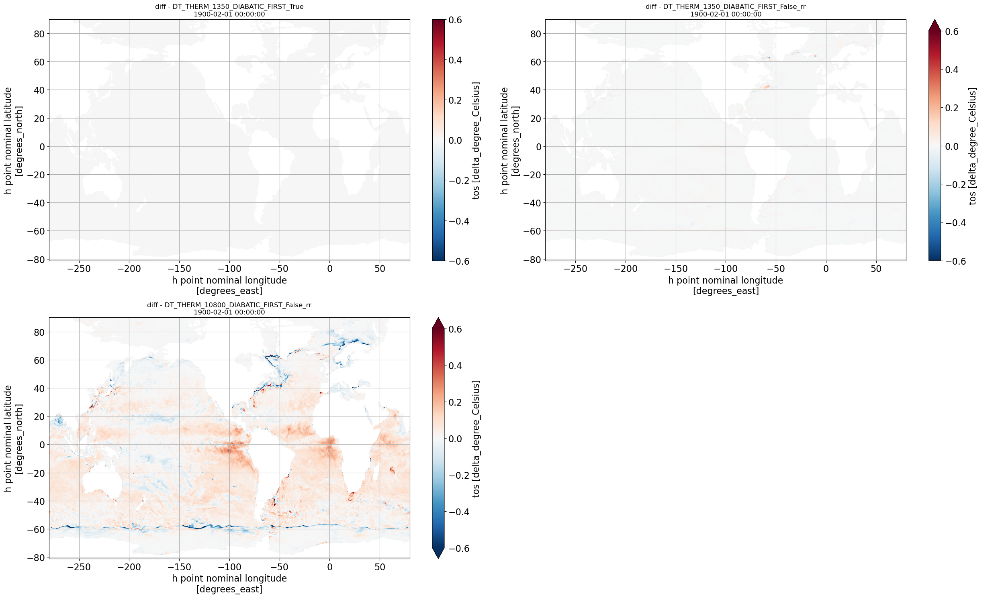

In [99]:
var = 'tos'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-0.6, 0.6],
      )
plt.tight_layout()
pic_name = "tos_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


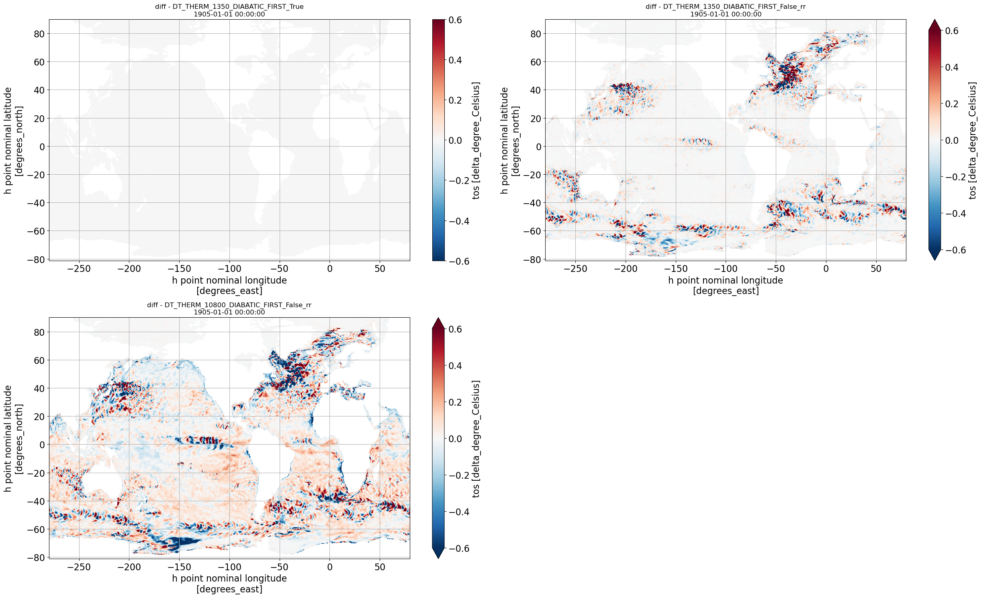

In [100]:
var = 'tos'
common_time = pd.Timestamp('1905-01-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-0.6, 0.6],
      )
plt.tight_layout()
pic_name = "tos_diff_2"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()